<a href="https://colab.research.google.com/github/kvong/DeepLearning-NeuralStyleTransfer/blob/master/Neural_Style_Transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Load Images Into Colab

In [0]:
! cp -r drive/My\ Drive/NeuralStyleTransfer-Pictures/Content/boat.jpg drive/My\ Drive/NeuralStyleTransfer-Pictures/Style/polygonlandscape.jpg ./ 
! ls

beautifulnight.jpg		my_result_at_iteration_480.png
boat.jpg			my_result_at_iteration_490.png
drive				my_result_at_iteration_500.png
my_result_at_iteration_0.png	my_result_at_iteration_50.png
my_result_at_iteration_100.png	my_result_at_iteration_510.png
my_result_at_iteration_10.png	my_result_at_iteration_520.png
my_result_at_iteration_110.png	my_result_at_iteration_530.png
my_result_at_iteration_120.png	my_result_at_iteration_540.png
my_result_at_iteration_130.png	my_result_at_iteration_550.png
my_result_at_iteration_140.png	my_result_at_iteration_560.png
my_result_at_iteration_150.png	my_result_at_iteration_570.png
my_result_at_iteration_160.png	my_result_at_iteration_580.png
my_result_at_iteration_170.png	my_result_at_iteration_590.png
my_result_at_iteration_180.png	my_result_at_iteration_600.png
my_result_at_iteration_190.png	my_result_at_iteration_60.png
my_result_at_iteration_200.png	my_result_at_iteration_610.png
my_result_at_iteration_20.png	my_result_at_iteration_620.png
my_re

In [0]:
from PIL import Image
import matplotlib.pyplot as plt

def show_image(name):
  image = Image.open(name)
  plt.imshow(image)
  plt.show()

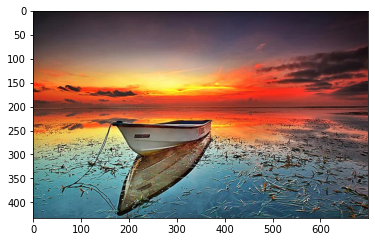

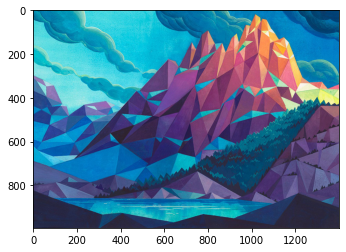

In [0]:
from tensorflow.keras.preprocessing.image import load_img, img_to_array

target_image_path = './boat.jpg'
style_image_path = './polygonlandscape.jpg'

# Preview image
show_image(target_image_path)
show_image(style_image_path)

# Define rescaled height(img_nrows) and width (img_ncols)
width, height = load_img(target_image_path).size
img_nrows = 400
img_ncols = int(width * img_nrows/ height)

In [0]:
import numpy as np
from tensorflow.keras.applications import vgg19

# Preprocess image to correct tensor format
def preprocess_image(image_path):
  img = load_img(image_path, target_size=(img_nrows, img_ncols))
  img = img_to_array(img)
  img = np.expand_dims(img, axis=0)
  img = vgg19.preprocess_input(img)
  return img

# Return processed image back to valid image; Needed for printing
def deprocess_image(x):
  if K.image_data_format() == 'channels_first':
    x = x.reshape((3, img_nrows, img_ncols))
    x = x.transpose((1, 2, 0))
  else:
    x = x.reshape((img_nrows, img_ncols, 3))
  x[:, :, 0] += 103.939
  x[:, :, 1] += 116.779
  x[:, :, 2] += 123.68
  x = x[:, :, ::-1]
  x = np.clip(x, 0, 255).astype('uint8')
  return x

## Functions for style transfer loss
* Content Loss:
  * Control the *subject* of the image we wish to keep in the generated image.
  * Look at the high level feature maps.
* Gram Matrix:
  * Inner(dot) product of the feature maps of a given layer.
    * "Dot product can be seen as how similar two verctors actually are."
  * Representation map of the correlations between the layer's features.

* Style Loss:
  * Tweak the *style* of the image we wish to keep in the generated image.
  * Looks at low level as well as high level feature maps.
  * We can use the gram matrix to measure the difference in style between the reference image and the generated image on **multiple** layers.
* Total Variation Loss:
  * Operates on the pixels (colors) of the generated image.
  * Encourages non-pixelated results.
  * Keep the generated image locally coherent


In [0]:
# Loss for subject of the image
def content_loss(base, combination):
  return K.sum(K.square(combination - base))

# Measure the correlation between layer using dot product
def gram_matrix(x):
  assert K.ndim(x) == 3
  if K.image_data_format() == 'channels_first':
    features = K.batch_flatten(x)
  else:
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
  gram = K.dot(features, K.transpose(features))
  return gram

# Loss for texture of the image
def style_loss(style, combination):
  assert K.ndim(style) == 3
  assert K.ndim(combination) == 3
  S = gram_matrix(style)
  C = gram_matrix(combination)
  channels = 3
  size = img_nrows * img_ncols
  return K.sum(K.square(S - C)) / (4. * (channels ** 2) * (size ** 2))

# Loss of the pixels of the image
def total_variation_loss(x):
  assert K.ndim(x) == 4
  if K.image_data_format() == 'channels_first':
    a = K.square(
        x[:, :, :img_nrows - 1, :img_ncols - 1] - x[:, :, 1:, :img_ncols - 1])
    b = K.square(
        x[:, :, :img_nrows - 1, :img_ncols - 1] - x[:, :, :img_nrows - 1, 1:])
  else:
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
  return K.sum(K.pow(a + b, 1.125))

## Importing a Pretrained Model

In [0]:
from tensorflow.keras import backend as K

# Get tensor representation of the images
base_image = K.variable(preprocess_image(target_image_path))
style_image = K.variable(preprocess_image(style_image_path))

# Create tensor for the generated image
if K.image_data_format() == 'channels_first':
  combination_image = K.placeholder((1, 3, img_nrows, img_ncols))
else:
  combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

# Combine all 3 images into a tensor
input_tensor = K.concatenate([base_image,
                              style_image,
                              combination_image], axis=0)

# Load VGG19 model pretrained on ImageNet
model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)                              
print('Model loaded.')                    

Model loaded.


## Minimizing the Loss:
  * We want to minimize the average of the three losses defined above.
  * Content Loss looks at a single upper layer of the convolution base.
  * Style Loss looks at filters at all level of the convolution base.
  * Total Variation Loss added at the end result.

In [0]:
# Get a dictionary of all layers
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

# Top layer holding the image content
content_layer = 'block5_conv2'

# Layers on multiple levels holding the style
style_layers = ['block1_conv1',
               'block2_conv1',
               'block3_conv1',
               'block4_conv1',
               'block5_conv1']

# Hyperparameter of the losses
total_variation_weight = 1e-2
style_weight = 10.               
content_weight = 0.025

# Adding content loss
loss = K.variable(0.)
layer_features = outputs_dict[content_layer]
target_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + (content_weight * content_loss(target_image_features, combination_features))

# Adding style loss
for layer_name in style_layers:
  layer_features = outputs_dict[layer_name] 
  style_reference_features = layer_features[1, :, :, :]
  combination_features = layer_features[2, :, :, :]
  sl = style_loss(style_reference_features, combination_features)
  loss = loss + ((style_weight / len(style_layers)) * sl)

# Adding total variation loss
loss = loss + (total_variation_weight * total_variation_loss(combination_image))

## Set up gradient-descent

In [0]:
import tensorflow as tf

tf.compat.v1.disable_eager_execution()

grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
  outputs += grads
else:
  outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

def eval_loss_and_grads(x):
  if K.image_data_format() == 'channels_first':
    x = x.reshape((1, 3, img_nrows, img_ncols))
  else:
    x = x.reshape((1, img_nrows, img_ncols, 3))
  outs = f_outputs([x])
  loss_value = outs[0]
  if len(outs[1:]) == 1:
    grad_values = outs[1].flatten().astype('float64')
  else:
    grad_values = np.array(outs[1:]).flatten().astype('float64')
  return loss_value, grad_values

# Set up this class to use scipy.optimize which require 
# loss and gradient inputed as two separate functions.
# This class allows us to compute loss and gradient on one pass
class Evaluator(object):
  def __init__(self):
    self.loss_value = None
    self.grad_values = None

  def loss(self, x):
    assert self.loss_value is None
    loss_value, grad_values = eval_loss_and_grads(x)
    self.loss_value = loss_value
    self.grad_values = grad_values
    return self.loss_value
    
  def grads(self, x):
    assert self.loss_value is not None
    grad_values = np.copy(self.grad_values)
    self.loss_value = None
    self.grad_values = None
    return grad_values

## Perform Style Transfer

Start of iteration:  0
Current loss:  38836190000.0


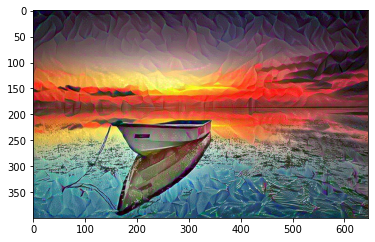

Image saved as:  my_result_at_iteration_0.png
Iteration 0 completed in 5s
Start of iteration:  1
Current loss:  20618797000.0
Iteration 1 completed in 4s
Start of iteration:  2
Current loss:  15334476000.0
Iteration 2 completed in 4s
Start of iteration:  3
Current loss:  12756239000.0
Iteration 3 completed in 4s
Start of iteration:  4
Current loss:  10933052000.0
Iteration 4 completed in 4s
Start of iteration:  5
Current loss:  9582324000.0
Iteration 5 completed in 4s
Start of iteration:  6
Current loss:  8366281000.0
Iteration 6 completed in 4s
Start of iteration:  7
Current loss:  7366706000.0
Iteration 7 completed in 4s
Start of iteration:  8
Current loss:  6472550400.0
Iteration 8 completed in 4s
Start of iteration:  9
Current loss:  5741164500.0
Iteration 9 completed in 4s
Start of iteration:  10
Current loss:  5078975000.0


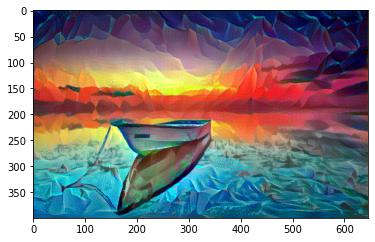

Image saved as:  my_result_at_iteration_10.png
Iteration 10 completed in 5s
Start of iteration:  11
Current loss:  4579481000.0
Iteration 11 completed in 4s
Start of iteration:  12
Current loss:  4149303000.0
Iteration 12 completed in 4s
Start of iteration:  13
Current loss:  3801720000.0
Iteration 13 completed in 4s
Start of iteration:  14
Current loss:  3488957200.0
Iteration 14 completed in 4s
Start of iteration:  15
Current loss:  3205039000.0
Iteration 15 completed in 5s
Start of iteration:  16
Current loss:  2955512000.0
Iteration 16 completed in 4s
Start of iteration:  17
Current loss:  2674798800.0
Iteration 17 completed in 5s
Start of iteration:  18
Current loss:  2443776300.0
Iteration 18 completed in 4s
Start of iteration:  19
Current loss:  2140680800.0
Iteration 19 completed in 5s
Start of iteration:  20
Current loss:  1941040500.0


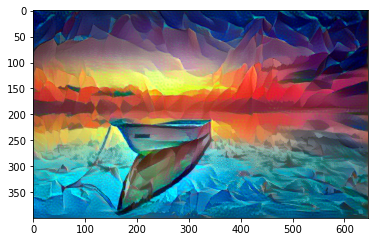

Image saved as:  my_result_at_iteration_20.png
Iteration 20 completed in 5s
Start of iteration:  21
Current loss:  1792433000.0
Iteration 21 completed in 4s
Start of iteration:  22
Current loss:  1672535700.0
Iteration 22 completed in 4s
Start of iteration:  23
Current loss:  1509267800.0
Iteration 23 completed in 5s
Start of iteration:  24
Current loss:  1390691500.0
Iteration 24 completed in 4s
Start of iteration:  25
Current loss:  1277190500.0
Iteration 25 completed in 5s
Start of iteration:  26
Current loss:  1203475800.0
Iteration 26 completed in 4s
Start of iteration:  27
Current loss:  1128667000.0
Iteration 27 completed in 5s
Start of iteration:  28
Current loss:  1075896600.0
Iteration 28 completed in 4s
Start of iteration:  29
Current loss:  1024872100.0
Iteration 29 completed in 4s
Start of iteration:  30
Current loss:  985342900.0


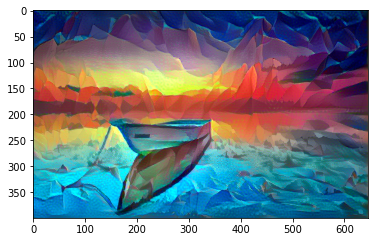

Image saved as:  my_result_at_iteration_30.png
Iteration 30 completed in 5s
Start of iteration:  31
Current loss:  938595140.0
Iteration 31 completed in 5s
Start of iteration:  32
Current loss:  896445440.0
Iteration 32 completed in 5s
Start of iteration:  33
Current loss:  865904800.0
Iteration 33 completed in 4s
Start of iteration:  34
Current loss:  837201340.0
Iteration 34 completed in 4s
Start of iteration:  35
Current loss:  812363500.0
Iteration 35 completed in 4s
Start of iteration:  36
Current loss:  771038850.0
Iteration 36 completed in 4s
Start of iteration:  37
Current loss:  734328300.0
Iteration 37 completed in 4s
Start of iteration:  38
Current loss:  705632000.0
Iteration 38 completed in 5s
Start of iteration:  39
Current loss:  683579400.0
Iteration 39 completed in 4s
Start of iteration:  40
Current loss:  655706750.0


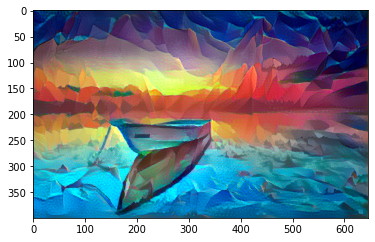

Image saved as:  my_result_at_iteration_40.png
Iteration 40 completed in 5s
Start of iteration:  41
Current loss:  635547260.0
Iteration 41 completed in 4s
Start of iteration:  42
Current loss:  619678800.0
Iteration 42 completed in 4s
Start of iteration:  43
Current loss:  603255040.0
Iteration 43 completed in 4s
Start of iteration:  44
Current loss:  586632600.0
Iteration 44 completed in 4s
Start of iteration:  45
Current loss:  571582850.0
Iteration 45 completed in 4s
Start of iteration:  46
Current loss:  559042100.0
Iteration 46 completed in 4s
Start of iteration:  47
Current loss:  547266100.0
Iteration 47 completed in 5s
Start of iteration:  48
Current loss:  534829630.0
Iteration 48 completed in 5s
Start of iteration:  49
Current loss:  524293570.0
Iteration 49 completed in 4s
Start of iteration:  50
Current loss:  509598200.0


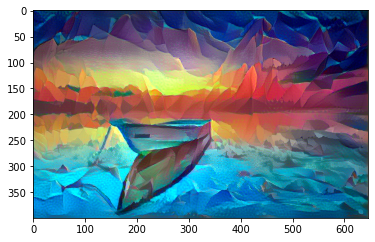

Image saved as:  my_result_at_iteration_50.png
Iteration 50 completed in 5s
Start of iteration:  51
Current loss:  495256800.0
Iteration 51 completed in 4s
Start of iteration:  52
Current loss:  484744500.0
Iteration 52 completed in 4s
Start of iteration:  53
Current loss:  476284930.0
Iteration 53 completed in 4s
Start of iteration:  54
Current loss:  469692960.0
Iteration 54 completed in 4s
Start of iteration:  55
Current loss:  463244060.0
Iteration 55 completed in 5s
Start of iteration:  56
Current loss:  454767400.0
Iteration 56 completed in 5s
Start of iteration:  57
Current loss:  448199580.0
Iteration 57 completed in 4s
Start of iteration:  58
Current loss:  439605220.0
Iteration 58 completed in 4s
Start of iteration:  59
Current loss:  432760420.0
Iteration 59 completed in 5s
Start of iteration:  60
Current loss:  426517100.0


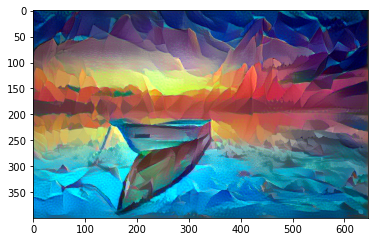

Image saved as:  my_result_at_iteration_60.png
Iteration 60 completed in 5s
Start of iteration:  61
Current loss:  420968450.0
Iteration 61 completed in 4s
Start of iteration:  62
Current loss:  416073020.0
Iteration 62 completed in 4s
Start of iteration:  63
Current loss:  411509250.0
Iteration 63 completed in 4s
Start of iteration:  64
Current loss:  406718900.0
Iteration 64 completed in 4s
Start of iteration:  65
Current loss:  401536100.0
Iteration 65 completed in 5s
Start of iteration:  66
Current loss:  397226200.0
Iteration 66 completed in 4s
Start of iteration:  67
Current loss:  393032450.0
Iteration 67 completed in 4s
Start of iteration:  68
Current loss:  389036130.0
Iteration 68 completed in 4s
Start of iteration:  69
Current loss:  385384100.0
Iteration 69 completed in 4s
Start of iteration:  70
Current loss:  378298850.0


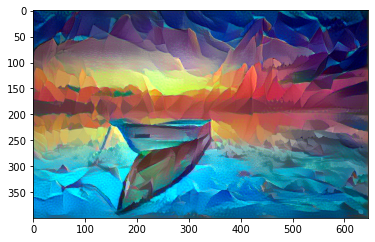

Image saved as:  my_result_at_iteration_70.png
Iteration 70 completed in 5s
Start of iteration:  71
Current loss:  372251140.0
Iteration 71 completed in 4s
Start of iteration:  72
Current loss:  365798720.0
Iteration 72 completed in 4s
Start of iteration:  73
Current loss:  358899330.0
Iteration 73 completed in 4s
Start of iteration:  74
Current loss:  350603650.0
Iteration 74 completed in 5s
Start of iteration:  75
Current loss:  343780000.0
Iteration 75 completed in 5s
Start of iteration:  76
Current loss:  340217900.0
Iteration 76 completed in 5s
Start of iteration:  77
Current loss:  337103200.0
Iteration 77 completed in 4s
Start of iteration:  78
Current loss:  334605300.0
Iteration 78 completed in 4s
Start of iteration:  79
Current loss:  331627970.0
Iteration 79 completed in 4s
Start of iteration:  80
Current loss:  328937600.0


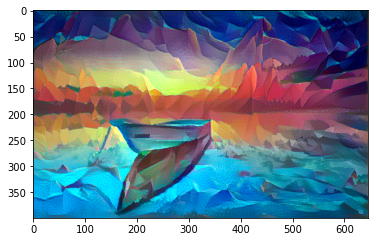

Image saved as:  my_result_at_iteration_80.png
Iteration 80 completed in 5s
Start of iteration:  81
Current loss:  326608420.0
Iteration 81 completed in 4s
Start of iteration:  82
Current loss:  324341250.0
Iteration 82 completed in 4s
Start of iteration:  83
Current loss:  321884060.0
Iteration 83 completed in 4s
Start of iteration:  84
Current loss:  319296540.0
Iteration 84 completed in 4s
Start of iteration:  85
Current loss:  316253220.0
Iteration 85 completed in 4s
Start of iteration:  86
Current loss:  313438050.0
Iteration 86 completed in 4s
Start of iteration:  87
Current loss:  310620030.0
Iteration 87 completed in 5s
Start of iteration:  88
Current loss:  307237400.0
Iteration 88 completed in 4s
Start of iteration:  89
Current loss:  303818200.0
Iteration 89 completed in 5s
Start of iteration:  90
Current loss:  300468540.0


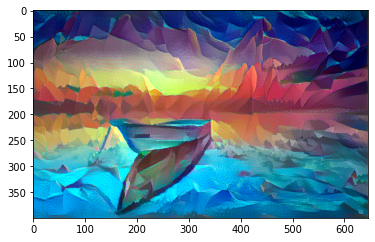

Image saved as:  my_result_at_iteration_90.png
Iteration 90 completed in 5s
Start of iteration:  91
Current loss:  298262000.0
Iteration 91 completed in 5s
Start of iteration:  92
Current loss:  296343500.0
Iteration 92 completed in 4s
Start of iteration:  93
Current loss:  294220700.0
Iteration 93 completed in 5s
Start of iteration:  94
Current loss:  291980600.0
Iteration 94 completed in 5s
Start of iteration:  95
Current loss:  290391360.0
Iteration 95 completed in 4s
Start of iteration:  96
Current loss:  288332350.0
Iteration 96 completed in 5s
Start of iteration:  97
Current loss:  286085400.0
Iteration 97 completed in 4s
Start of iteration:  98
Current loss:  283821380.0
Iteration 98 completed in 5s
Start of iteration:  99
Current loss:  282150620.0
Iteration 99 completed in 4s
Start of iteration:  100
Current loss:  280524800.0


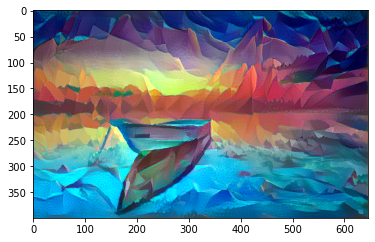

Image saved as:  my_result_at_iteration_100.png
Iteration 100 completed in 5s
Start of iteration:  101
Current loss:  278956060.0
Iteration 101 completed in 5s
Start of iteration:  102
Current loss:  277395870.0
Iteration 102 completed in 5s
Start of iteration:  103
Current loss:  275191140.0
Iteration 103 completed in 5s
Start of iteration:  104
Current loss:  272718270.0
Iteration 104 completed in 4s
Start of iteration:  105
Current loss:  270976740.0
Iteration 105 completed in 5s
Start of iteration:  106
Current loss:  268997000.0
Iteration 106 completed in 4s
Start of iteration:  107
Current loss:  267091630.0
Iteration 107 completed in 4s
Start of iteration:  108
Current loss:  265171950.0
Iteration 108 completed in 4s
Start of iteration:  109
Current loss:  262642240.0
Iteration 109 completed in 5s
Start of iteration:  110
Current loss:  260443730.0


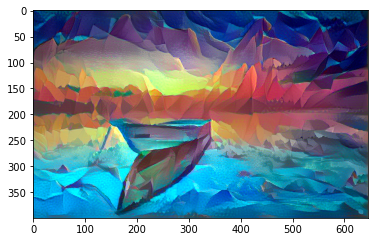

Image saved as:  my_result_at_iteration_110.png
Iteration 110 completed in 5s
Start of iteration:  111
Current loss:  258807220.0
Iteration 111 completed in 5s
Start of iteration:  112
Current loss:  257394100.0
Iteration 112 completed in 4s
Start of iteration:  113
Current loss:  255957500.0
Iteration 113 completed in 4s
Start of iteration:  114
Current loss:  254643220.0
Iteration 114 completed in 4s
Start of iteration:  115
Current loss:  253030500.0
Iteration 115 completed in 5s
Start of iteration:  116
Current loss:  251584140.0
Iteration 116 completed in 4s
Start of iteration:  117
Current loss:  250288400.0
Iteration 117 completed in 4s
Start of iteration:  118
Current loss:  248349090.0
Iteration 118 completed in 4s
Start of iteration:  119
Current loss:  246976700.0
Iteration 119 completed in 4s
Start of iteration:  120
Current loss:  245670500.0


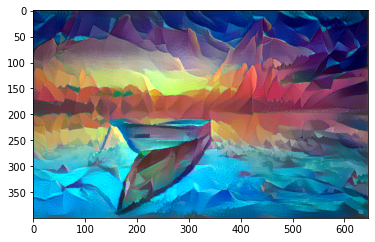

Image saved as:  my_result_at_iteration_120.png
Iteration 120 completed in 5s
Start of iteration:  121
Current loss:  244322200.0
Iteration 121 completed in 4s
Start of iteration:  122
Current loss:  242966770.0
Iteration 122 completed in 4s
Start of iteration:  123
Current loss:  241063420.0
Iteration 123 completed in 5s
Start of iteration:  124
Current loss:  239222820.0
Iteration 124 completed in 4s
Start of iteration:  125
Current loss:  237930720.0
Iteration 125 completed in 4s
Start of iteration:  126
Current loss:  236710510.0
Iteration 126 completed in 5s
Start of iteration:  127
Current loss:  235503500.0
Iteration 127 completed in 5s
Start of iteration:  128
Current loss:  234442030.0
Iteration 128 completed in 5s
Start of iteration:  129
Current loss:  233643730.0
Iteration 129 completed in 4s
Start of iteration:  130
Current loss:  232653330.0


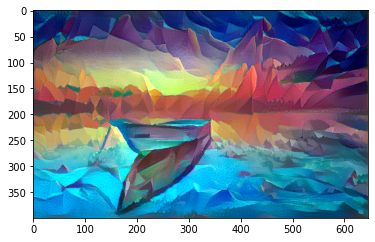

Image saved as:  my_result_at_iteration_130.png
Iteration 130 completed in 5s
Start of iteration:  131
Current loss:  231772180.0
Iteration 131 completed in 4s
Start of iteration:  132
Current loss:  230868130.0
Iteration 132 completed in 4s
Start of iteration:  133
Current loss:  230030340.0
Iteration 133 completed in 5s
Start of iteration:  134
Current loss:  229032590.0
Iteration 134 completed in 5s
Start of iteration:  135
Current loss:  228168140.0
Iteration 135 completed in 4s
Start of iteration:  136
Current loss:  227343550.0
Iteration 136 completed in 4s
Start of iteration:  137
Current loss:  226642720.0
Iteration 137 completed in 4s
Start of iteration:  138
Current loss:  225728160.0
Iteration 138 completed in 4s
Start of iteration:  139
Current loss:  224736580.0
Iteration 139 completed in 4s
Start of iteration:  140
Current loss:  223668750.0


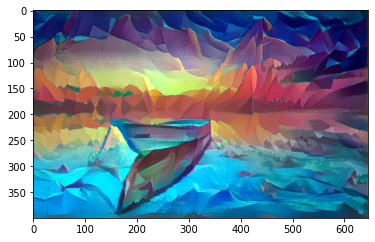

Image saved as:  my_result_at_iteration_140.png
Iteration 140 completed in 5s
Start of iteration:  141
Current loss:  222771710.0
Iteration 141 completed in 5s
Start of iteration:  142
Current loss:  221836930.0
Iteration 142 completed in 5s
Start of iteration:  143
Current loss:  221002380.0
Iteration 143 completed in 4s
Start of iteration:  144
Current loss:  220246420.0
Iteration 144 completed in 4s
Start of iteration:  145
Current loss:  219444620.0
Iteration 145 completed in 4s
Start of iteration:  146
Current loss:  218654880.0
Iteration 146 completed in 4s
Start of iteration:  147
Current loss:  217866260.0
Iteration 147 completed in 5s
Start of iteration:  148
Current loss:  217133230.0
Iteration 148 completed in 4s
Start of iteration:  149
Current loss:  216385820.0
Iteration 149 completed in 5s
Start of iteration:  150
Current loss:  215532930.0


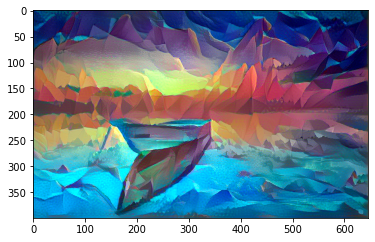

Image saved as:  my_result_at_iteration_150.png
Iteration 150 completed in 5s
Start of iteration:  151
Current loss:  214681380.0
Iteration 151 completed in 5s
Start of iteration:  152
Current loss:  214007570.0
Iteration 152 completed in 4s
Start of iteration:  153
Current loss:  213244500.0
Iteration 153 completed in 4s
Start of iteration:  154
Current loss:  212579660.0
Iteration 154 completed in 4s
Start of iteration:  155
Current loss:  211902080.0
Iteration 155 completed in 5s
Start of iteration:  156
Current loss:  211194430.0
Iteration 156 completed in 5s
Start of iteration:  157
Current loss:  210584800.0
Iteration 157 completed in 5s
Start of iteration:  158
Current loss:  209933780.0
Iteration 158 completed in 4s
Start of iteration:  159
Current loss:  209293420.0
Iteration 159 completed in 4s
Start of iteration:  160
Current loss:  208658160.0


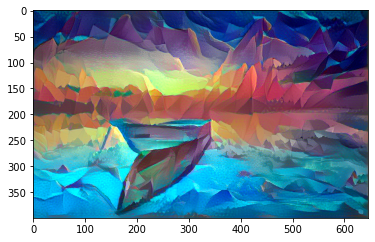

Image saved as:  my_result_at_iteration_160.png
Iteration 160 completed in 5s
Start of iteration:  161
Current loss:  208112750.0
Iteration 161 completed in 4s
Start of iteration:  162
Current loss:  207565440.0
Iteration 162 completed in 4s
Start of iteration:  163
Current loss:  206958940.0
Iteration 163 completed in 4s
Start of iteration:  164
Current loss:  206396980.0
Iteration 164 completed in 4s
Start of iteration:  165
Current loss:  205655540.0
Iteration 165 completed in 4s
Start of iteration:  166
Current loss:  204984980.0
Iteration 166 completed in 5s
Start of iteration:  167
Current loss:  204344620.0
Iteration 167 completed in 4s
Start of iteration:  168
Current loss:  203752290.0
Iteration 168 completed in 4s
Start of iteration:  169
Current loss:  203164320.0
Iteration 169 completed in 5s
Start of iteration:  170
Current loss:  202568420.0


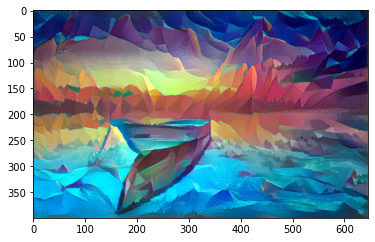

Image saved as:  my_result_at_iteration_170.png
Iteration 170 completed in 5s
Start of iteration:  171
Current loss:  201997900.0
Iteration 171 completed in 4s
Start of iteration:  172
Current loss:  201382200.0
Iteration 172 completed in 4s
Start of iteration:  173
Current loss:  200824260.0
Iteration 173 completed in 4s
Start of iteration:  174
Current loss:  200285440.0
Iteration 174 completed in 4s
Start of iteration:  175
Current loss:  199751260.0
Iteration 175 completed in 4s
Start of iteration:  176
Current loss:  199082580.0
Iteration 176 completed in 4s
Start of iteration:  177
Current loss:  198310720.0
Iteration 177 completed in 5s
Start of iteration:  178
Current loss:  197715760.0
Iteration 178 completed in 5s
Start of iteration:  179
Current loss:  197204480.0
Iteration 179 completed in 4s
Start of iteration:  180
Current loss:  196491260.0


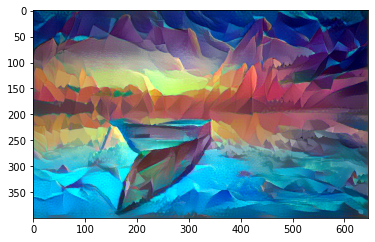

Image saved as:  my_result_at_iteration_180.png
Iteration 180 completed in 5s
Start of iteration:  181
Current loss:  195705200.0
Iteration 181 completed in 4s
Start of iteration:  182
Current loss:  195124290.0
Iteration 182 completed in 4s
Start of iteration:  183
Current loss:  194486600.0
Iteration 183 completed in 5s
Start of iteration:  184
Current loss:  194026000.0
Iteration 184 completed in 4s
Start of iteration:  185
Current loss:  193593020.0
Iteration 185 completed in 4s
Start of iteration:  186
Current loss:  193157020.0
Iteration 186 completed in 5s
Start of iteration:  187
Current loss:  192646990.0
Iteration 187 completed in 4s
Start of iteration:  188
Current loss:  192224980.0
Iteration 188 completed in 4s
Start of iteration:  189
Current loss:  191701940.0
Iteration 189 completed in 4s
Start of iteration:  190
Current loss:  191190460.0


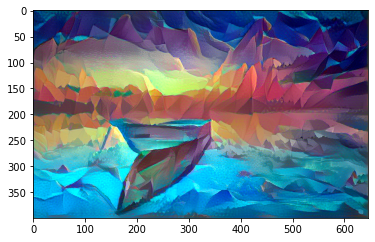

Image saved as:  my_result_at_iteration_190.png
Iteration 190 completed in 5s
Start of iteration:  191
Current loss:  190665650.0
Iteration 191 completed in 4s
Start of iteration:  192
Current loss:  190254140.0
Iteration 192 completed in 4s
Start of iteration:  193
Current loss:  189784940.0
Iteration 193 completed in 4s
Start of iteration:  194
Current loss:  189186320.0
Iteration 194 completed in 4s
Start of iteration:  195
Current loss:  188543150.0
Iteration 195 completed in 5s
Start of iteration:  196
Current loss:  188073340.0
Iteration 196 completed in 4s
Start of iteration:  197
Current loss:  187630300.0
Iteration 197 completed in 4s
Start of iteration:  198
Current loss:  187145890.0
Iteration 198 completed in 4s
Start of iteration:  199
Current loss:  186674200.0
Iteration 199 completed in 4s
Start of iteration:  200
Current loss:  186319660.0


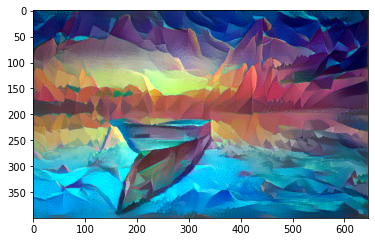

Image saved as:  my_result_at_iteration_200.png
Iteration 200 completed in 5s
Start of iteration:  201
Current loss:  185893920.0
Iteration 201 completed in 4s
Start of iteration:  202
Current loss:  185500620.0
Iteration 202 completed in 4s
Start of iteration:  203
Current loss:  185087220.0
Iteration 203 completed in 4s
Start of iteration:  204
Current loss:  184701300.0
Iteration 204 completed in 4s
Start of iteration:  205
Current loss:  184297660.0
Iteration 205 completed in 4s
Start of iteration:  206
Current loss:  183929150.0
Iteration 206 completed in 4s
Start of iteration:  207
Current loss:  183553550.0
Iteration 207 completed in 4s
Start of iteration:  208
Current loss:  183112600.0
Iteration 208 completed in 4s
Start of iteration:  209
Current loss:  182644980.0
Iteration 209 completed in 4s
Start of iteration:  210
Current loss:  182254670.0


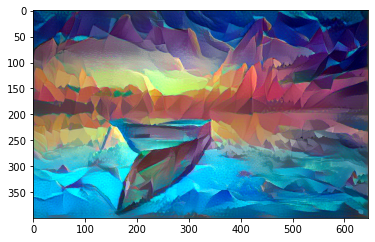

Image saved as:  my_result_at_iteration_210.png
Iteration 210 completed in 5s
Start of iteration:  211
Current loss:  181892540.0
Iteration 211 completed in 4s
Start of iteration:  212
Current loss:  181338380.0
Iteration 212 completed in 5s
Start of iteration:  213
Current loss:  180836540.0
Iteration 213 completed in 4s
Start of iteration:  214
Current loss:  180253860.0
Iteration 214 completed in 4s
Start of iteration:  215
Current loss:  179655460.0
Iteration 215 completed in 5s
Start of iteration:  216
Current loss:  179288670.0
Iteration 216 completed in 4s
Start of iteration:  217
Current loss:  178850450.0
Iteration 217 completed in 5s
Start of iteration:  218
Current loss:  178485070.0
Iteration 218 completed in 4s
Start of iteration:  219
Current loss:  178039660.0
Iteration 219 completed in 4s
Start of iteration:  220
Current loss:  177695630.0


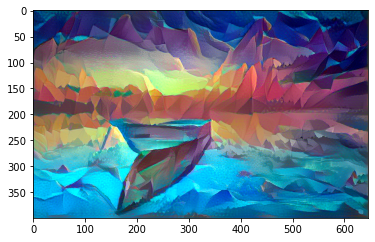

Image saved as:  my_result_at_iteration_220.png
Iteration 220 completed in 5s
Start of iteration:  221
Current loss:  177287760.0
Iteration 221 completed in 4s
Start of iteration:  222
Current loss:  176880400.0
Iteration 222 completed in 4s
Start of iteration:  223
Current loss:  176451400.0
Iteration 223 completed in 4s
Start of iteration:  224
Current loss:  176008350.0
Iteration 224 completed in 4s
Start of iteration:  225
Current loss:  175629940.0
Iteration 225 completed in 4s
Start of iteration:  226
Current loss:  175311760.0
Iteration 226 completed in 4s
Start of iteration:  227
Current loss:  175003490.0
Iteration 227 completed in 4s
Start of iteration:  228
Current loss:  174526200.0
Iteration 228 completed in 4s
Start of iteration:  229
Current loss:  174099100.0
Iteration 229 completed in 4s
Start of iteration:  230
Current loss:  173695730.0


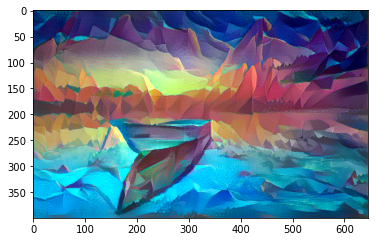

Image saved as:  my_result_at_iteration_230.png
Iteration 230 completed in 5s
Start of iteration:  231
Current loss:  173300560.0
Iteration 231 completed in 4s
Start of iteration:  232
Current loss:  172885250.0
Iteration 232 completed in 4s
Start of iteration:  233
Current loss:  172526340.0
Iteration 233 completed in 4s
Start of iteration:  234
Current loss:  172273440.0
Iteration 234 completed in 4s
Start of iteration:  235
Current loss:  171912080.0
Iteration 235 completed in 4s
Start of iteration:  236
Current loss:  171508750.0
Iteration 236 completed in 5s
Start of iteration:  237
Current loss:  171067200.0
Iteration 237 completed in 4s
Start of iteration:  238
Current loss:  170556770.0
Iteration 238 completed in 5s
Start of iteration:  239
Current loss:  170163700.0
Iteration 239 completed in 4s
Start of iteration:  240
Current loss:  169764960.0


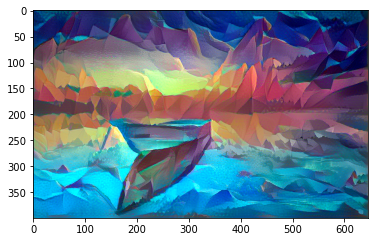

Image saved as:  my_result_at_iteration_240.png
Iteration 240 completed in 5s
Start of iteration:  241
Current loss:  169486480.0
Iteration 241 completed in 4s
Start of iteration:  242
Current loss:  169199200.0
Iteration 242 completed in 4s
Start of iteration:  243
Current loss:  168880460.0
Iteration 243 completed in 4s
Start of iteration:  244
Current loss:  168558200.0
Iteration 244 completed in 4s
Start of iteration:  245
Current loss:  168286750.0
Iteration 245 completed in 4s
Start of iteration:  246
Current loss:  168031870.0
Iteration 246 completed in 4s
Start of iteration:  247
Current loss:  167755470.0
Iteration 247 completed in 4s
Start of iteration:  248
Current loss:  167485380.0
Iteration 248 completed in 4s
Start of iteration:  249
Current loss:  167181660.0
Iteration 249 completed in 4s
Start of iteration:  250
Current loss:  166886910.0


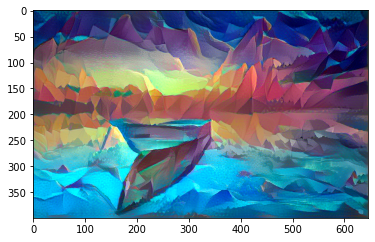

Image saved as:  my_result_at_iteration_250.png
Iteration 250 completed in 5s
Start of iteration:  251
Current loss:  166572830.0
Iteration 251 completed in 5s
Start of iteration:  252
Current loss:  166265890.0
Iteration 252 completed in 4s
Start of iteration:  253
Current loss:  165979900.0
Iteration 253 completed in 4s
Start of iteration:  254
Current loss:  165662700.0
Iteration 254 completed in 4s
Start of iteration:  255
Current loss:  165340860.0
Iteration 255 completed in 4s
Start of iteration:  256
Current loss:  165035410.0
Iteration 256 completed in 4s
Start of iteration:  257
Current loss:  164717710.0
Iteration 257 completed in 4s
Start of iteration:  258
Current loss:  164469000.0
Iteration 258 completed in 4s
Start of iteration:  259
Current loss:  164217200.0
Iteration 259 completed in 4s
Start of iteration:  260
Current loss:  163982880.0


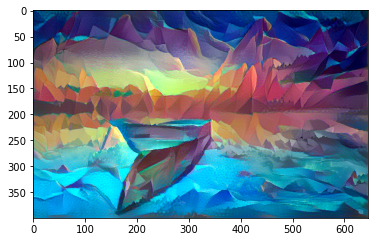

Image saved as:  my_result_at_iteration_260.png
Iteration 260 completed in 5s
Start of iteration:  261
Current loss:  163709280.0
Iteration 261 completed in 5s
Start of iteration:  262
Current loss:  163461090.0
Iteration 262 completed in 4s
Start of iteration:  263
Current loss:  163118000.0
Iteration 263 completed in 4s
Start of iteration:  264
Current loss:  162850620.0
Iteration 264 completed in 4s
Start of iteration:  265
Current loss:  162591980.0
Iteration 265 completed in 4s
Start of iteration:  266
Current loss:  162363040.0
Iteration 266 completed in 4s
Start of iteration:  267
Current loss:  162092370.0
Iteration 267 completed in 4s
Start of iteration:  268
Current loss:  161844560.0
Iteration 268 completed in 4s
Start of iteration:  269
Current loss:  161559090.0
Iteration 269 completed in 4s
Start of iteration:  270
Current loss:  161065440.0


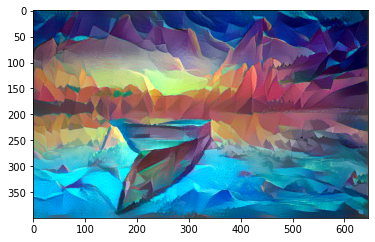

Image saved as:  my_result_at_iteration_270.png
Iteration 270 completed in 5s
Start of iteration:  271
Current loss:  160492590.0
Iteration 271 completed in 4s
Start of iteration:  272
Current loss:  160189500.0
Iteration 272 completed in 4s
Start of iteration:  273
Current loss:  159932300.0
Iteration 273 completed in 4s
Start of iteration:  274
Current loss:  159715380.0
Iteration 274 completed in 4s
Start of iteration:  275
Current loss:  159480930.0
Iteration 275 completed in 4s
Start of iteration:  276
Current loss:  159255660.0
Iteration 276 completed in 4s
Start of iteration:  277
Current loss:  158986940.0
Iteration 277 completed in 4s
Start of iteration:  278
Current loss:  158705890.0
Iteration 278 completed in 5s
Start of iteration:  279
Current loss:  158446900.0
Iteration 279 completed in 4s
Start of iteration:  280
Current loss:  158154980.0


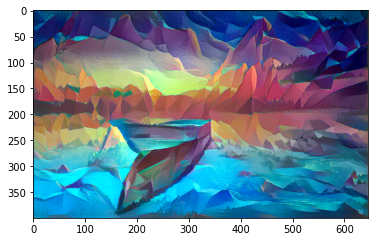

Image saved as:  my_result_at_iteration_280.png
Iteration 280 completed in 5s
Start of iteration:  281
Current loss:  157865760.0
Iteration 281 completed in 4s
Start of iteration:  282
Current loss:  157624370.0
Iteration 282 completed in 4s
Start of iteration:  283
Current loss:  157382140.0
Iteration 283 completed in 4s
Start of iteration:  284
Current loss:  157088320.0
Iteration 284 completed in 4s
Start of iteration:  285
Current loss:  156825400.0
Iteration 285 completed in 4s
Start of iteration:  286
Current loss:  156600420.0
Iteration 286 completed in 4s
Start of iteration:  287
Current loss:  156365600.0
Iteration 287 completed in 4s
Start of iteration:  288
Current loss:  156181860.0
Iteration 288 completed in 4s
Start of iteration:  289
Current loss:  155982400.0
Iteration 289 completed in 4s
Start of iteration:  290
Current loss:  155687380.0


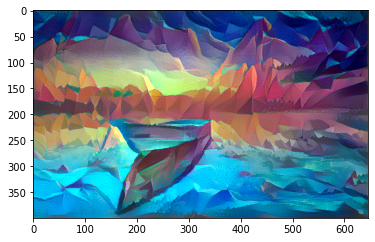

Image saved as:  my_result_at_iteration_290.png
Iteration 290 completed in 5s
Start of iteration:  291
Current loss:  155398340.0
Iteration 291 completed in 4s
Start of iteration:  292
Current loss:  155147280.0
Iteration 292 completed in 4s
Start of iteration:  293
Current loss:  154935650.0
Iteration 293 completed in 4s
Start of iteration:  294
Current loss:  154693060.0
Iteration 294 completed in 4s
Start of iteration:  295
Current loss:  154411000.0
Iteration 295 completed in 4s
Start of iteration:  296
Current loss:  154143380.0
Iteration 296 completed in 4s
Start of iteration:  297
Current loss:  153889870.0
Iteration 297 completed in 5s
Start of iteration:  298
Current loss:  153703660.0
Iteration 298 completed in 4s
Start of iteration:  299
Current loss:  153521060.0
Iteration 299 completed in 4s
Start of iteration:  300
Current loss:  153282980.0


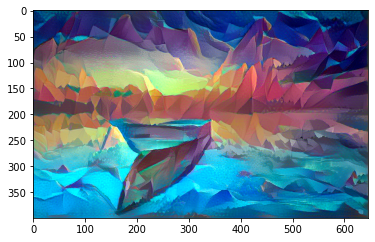

Image saved as:  my_result_at_iteration_300.png
Iteration 300 completed in 5s
Start of iteration:  301
Current loss:  153046000.0
Iteration 301 completed in 5s
Start of iteration:  302
Current loss:  152723980.0
Iteration 302 completed in 4s
Start of iteration:  303
Current loss:  152341470.0
Iteration 303 completed in 4s
Start of iteration:  304
Current loss:  152077570.0
Iteration 304 completed in 4s
Start of iteration:  305
Current loss:  151778670.0
Iteration 305 completed in 4s
Start of iteration:  306
Current loss:  151578050.0
Iteration 306 completed in 4s
Start of iteration:  307
Current loss:  151362530.0
Iteration 307 completed in 4s
Start of iteration:  308
Current loss:  151136880.0
Iteration 308 completed in 4s
Start of iteration:  309
Current loss:  150913380.0
Iteration 309 completed in 4s
Start of iteration:  310
Current loss:  150715180.0


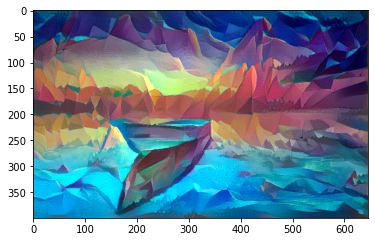

Image saved as:  my_result_at_iteration_310.png
Iteration 310 completed in 5s
Start of iteration:  311
Current loss:  150439060.0
Iteration 311 completed in 5s
Start of iteration:  312
Current loss:  150254980.0
Iteration 312 completed in 4s
Start of iteration:  313
Current loss:  150059500.0
Iteration 313 completed in 4s
Start of iteration:  314
Current loss:  149886690.0
Iteration 314 completed in 4s
Start of iteration:  315
Current loss:  149696750.0
Iteration 315 completed in 4s
Start of iteration:  316
Current loss:  149525220.0
Iteration 316 completed in 4s
Start of iteration:  317
Current loss:  149369760.0
Iteration 317 completed in 4s
Start of iteration:  318
Current loss:  149205000.0
Iteration 318 completed in 4s
Start of iteration:  319
Current loss:  148872050.0
Iteration 319 completed in 4s
Start of iteration:  320
Current loss:  148536460.0


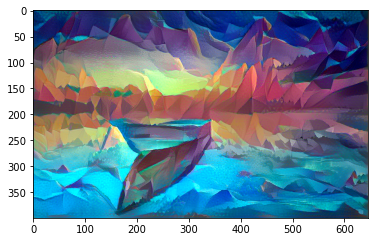

Image saved as:  my_result_at_iteration_320.png
Iteration 320 completed in 5s
Start of iteration:  321
Current loss:  148374370.0
Iteration 321 completed in 4s
Start of iteration:  322
Current loss:  148214300.0
Iteration 322 completed in 4s
Start of iteration:  323
Current loss:  148028900.0
Iteration 323 completed in 4s
Start of iteration:  324
Current loss:  147859780.0
Iteration 324 completed in 4s
Start of iteration:  325
Current loss:  147576270.0
Iteration 325 completed in 4s
Start of iteration:  326
Current loss:  147260830.0
Iteration 326 completed in 4s
Start of iteration:  327
Current loss:  147020030.0
Iteration 327 completed in 4s
Start of iteration:  328
Current loss:  146838660.0
Iteration 328 completed in 4s
Start of iteration:  329
Current loss:  146645900.0
Iteration 329 completed in 4s
Start of iteration:  330
Current loss:  146450110.0


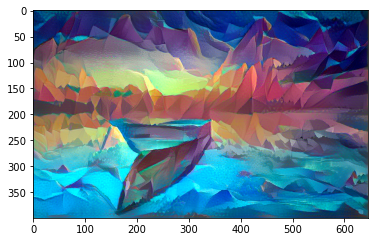

Image saved as:  my_result_at_iteration_330.png
Iteration 330 completed in 5s
Start of iteration:  331
Current loss:  146235230.0
Iteration 331 completed in 4s
Start of iteration:  332
Current loss:  145996930.0
Iteration 332 completed in 4s
Start of iteration:  333
Current loss:  145822620.0
Iteration 333 completed in 4s
Start of iteration:  334
Current loss:  145614990.0
Iteration 334 completed in 4s
Start of iteration:  335
Current loss:  145411700.0
Iteration 335 completed in 4s
Start of iteration:  336
Current loss:  145184720.0
Iteration 336 completed in 4s
Start of iteration:  337
Current loss:  144999900.0
Iteration 337 completed in 4s
Start of iteration:  338
Current loss:  144775220.0
Iteration 338 completed in 4s
Start of iteration:  339
Current loss:  144589150.0
Iteration 339 completed in 4s
Start of iteration:  340
Current loss:  144368830.0


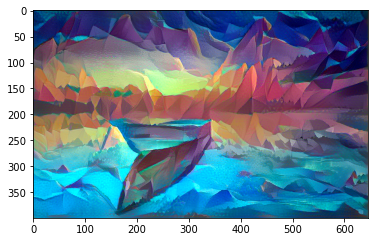

Image saved as:  my_result_at_iteration_340.png
Iteration 340 completed in 5s
Start of iteration:  341
Current loss:  144192400.0
Iteration 341 completed in 4s
Start of iteration:  342
Current loss:  144002020.0
Iteration 342 completed in 4s
Start of iteration:  343
Current loss:  143801360.0
Iteration 343 completed in 4s
Start of iteration:  344
Current loss:  143582370.0
Iteration 344 completed in 4s
Start of iteration:  345
Current loss:  143417800.0
Iteration 345 completed in 4s
Start of iteration:  346
Current loss:  143232590.0
Iteration 346 completed in 4s
Start of iteration:  347
Current loss:  143080320.0
Iteration 347 completed in 4s
Start of iteration:  348
Current loss:  142906620.0
Iteration 348 completed in 4s
Start of iteration:  349
Current loss:  142758460.0
Iteration 349 completed in 4s
Start of iteration:  350
Current loss:  142581260.0


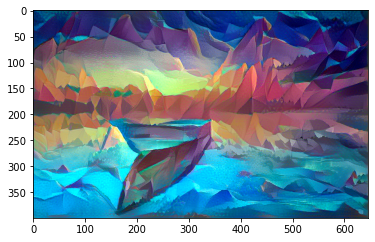

Image saved as:  my_result_at_iteration_350.png
Iteration 350 completed in 5s
Start of iteration:  351
Current loss:  142434940.0
Iteration 351 completed in 4s
Start of iteration:  352
Current loss:  142278050.0
Iteration 352 completed in 4s
Start of iteration:  353
Current loss:  142111900.0
Iteration 353 completed in 4s
Start of iteration:  354
Current loss:  141897860.0
Iteration 354 completed in 4s
Start of iteration:  355
Current loss:  141756660.0
Iteration 355 completed in 4s
Start of iteration:  356
Current loss:  141559040.0
Iteration 356 completed in 5s
Start of iteration:  357
Current loss:  141390030.0
Iteration 357 completed in 4s
Start of iteration:  358
Current loss:  141226740.0
Iteration 358 completed in 4s
Start of iteration:  359
Current loss:  141085970.0
Iteration 359 completed in 4s
Start of iteration:  360
Current loss:  140923000.0


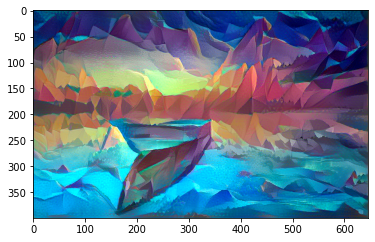

Image saved as:  my_result_at_iteration_360.png
Iteration 360 completed in 5s
Start of iteration:  361
Current loss:  140753470.0
Iteration 361 completed in 4s
Start of iteration:  362
Current loss:  140540860.0
Iteration 362 completed in 5s
Start of iteration:  363
Current loss:  140379800.0
Iteration 363 completed in 4s
Start of iteration:  364
Current loss:  140202320.0
Iteration 364 completed in 4s
Start of iteration:  365
Current loss:  139987840.0
Iteration 365 completed in 4s
Start of iteration:  366
Current loss:  139727150.0
Iteration 366 completed in 4s
Start of iteration:  367
Current loss:  139571410.0
Iteration 367 completed in 4s
Start of iteration:  368
Current loss:  139438540.0
Iteration 368 completed in 4s
Start of iteration:  369
Current loss:  139192770.0
Iteration 369 completed in 4s
Start of iteration:  370
Current loss:  138925970.0


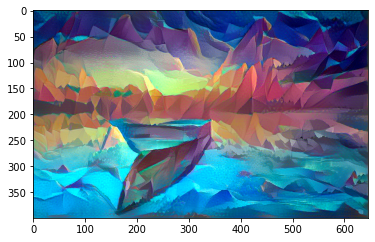

Image saved as:  my_result_at_iteration_370.png
Iteration 370 completed in 5s
Start of iteration:  371
Current loss:  138673740.0
Iteration 371 completed in 4s
Start of iteration:  372
Current loss:  138458850.0
Iteration 372 completed in 4s
Start of iteration:  373
Current loss:  138323940.0
Iteration 373 completed in 4s
Start of iteration:  374
Current loss:  138160560.0
Iteration 374 completed in 4s
Start of iteration:  375
Current loss:  138032100.0
Iteration 375 completed in 5s
Start of iteration:  376
Current loss:  137886960.0
Iteration 376 completed in 4s
Start of iteration:  377
Current loss:  137739140.0
Iteration 377 completed in 4s
Start of iteration:  378
Current loss:  137621340.0
Iteration 378 completed in 4s
Start of iteration:  379
Current loss:  137505580.0
Iteration 379 completed in 4s
Start of iteration:  380
Current loss:  137382660.0


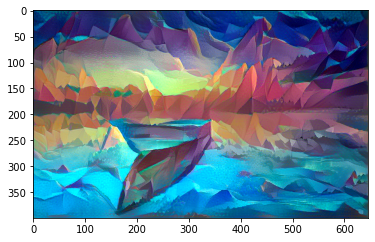

Image saved as:  my_result_at_iteration_380.png
Iteration 380 completed in 5s
Start of iteration:  381
Current loss:  137264510.0
Iteration 381 completed in 4s
Start of iteration:  382
Current loss:  137148700.0
Iteration 382 completed in 4s
Start of iteration:  383
Current loss:  137043650.0
Iteration 383 completed in 4s
Start of iteration:  384
Current loss:  136907360.0
Iteration 384 completed in 4s
Start of iteration:  385
Current loss:  136771070.0
Iteration 385 completed in 4s
Start of iteration:  386
Current loss:  136613460.0
Iteration 386 completed in 4s
Start of iteration:  387
Current loss:  136481100.0
Iteration 387 completed in 4s
Start of iteration:  388
Current loss:  136314990.0
Iteration 388 completed in 4s
Start of iteration:  389
Current loss:  136186400.0
Iteration 389 completed in 4s
Start of iteration:  390
Current loss:  136020030.0


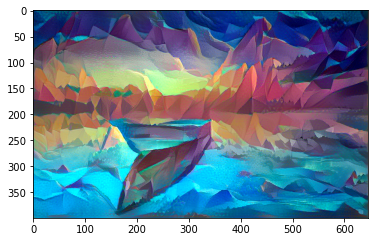

Image saved as:  my_result_at_iteration_390.png
Iteration 390 completed in 5s
Start of iteration:  391
Current loss:  135895140.0
Iteration 391 completed in 4s
Start of iteration:  392
Current loss:  135764430.0
Iteration 392 completed in 4s
Start of iteration:  393
Current loss:  135617620.0
Iteration 393 completed in 4s
Start of iteration:  394
Current loss:  135367020.0
Iteration 394 completed in 4s
Start of iteration:  395
Current loss:  135197660.0
Iteration 395 completed in 4s
Start of iteration:  396
Current loss:  135045580.0
Iteration 396 completed in 4s
Start of iteration:  397
Current loss:  134923920.0
Iteration 397 completed in 4s
Start of iteration:  398
Current loss:  134810200.0
Iteration 398 completed in 4s
Start of iteration:  399
Current loss:  134707780.0
Iteration 399 completed in 4s
Start of iteration:  400
Current loss:  134590530.0


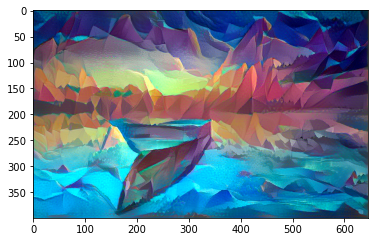

Image saved as:  my_result_at_iteration_400.png
Iteration 400 completed in 5s
Start of iteration:  401
Current loss:  134463500.0
Iteration 401 completed in 4s
Start of iteration:  402
Current loss:  134343570.0
Iteration 402 completed in 4s
Start of iteration:  403
Current loss:  134214530.0
Iteration 403 completed in 4s
Start of iteration:  404
Current loss:  134107680.0
Iteration 404 completed in 4s
Start of iteration:  405
Current loss:  133968136.0
Iteration 405 completed in 4s
Start of iteration:  406
Current loss:  133845140.0
Iteration 406 completed in 4s
Start of iteration:  407
Current loss:  133698850.0
Iteration 407 completed in 4s
Start of iteration:  408
Current loss:  133587460.0
Iteration 408 completed in 4s
Start of iteration:  409
Current loss:  133475510.0
Iteration 409 completed in 4s
Start of iteration:  410
Current loss:  133361620.0


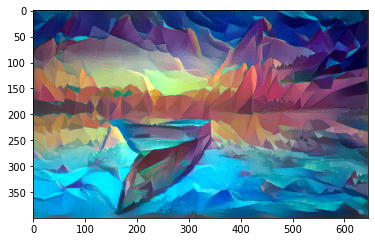

Image saved as:  my_result_at_iteration_410.png
Iteration 410 completed in 5s
Start of iteration:  411
Current loss:  133254216.0
Iteration 411 completed in 4s
Start of iteration:  412
Current loss:  133101864.0
Iteration 412 completed in 4s
Start of iteration:  413
Current loss:  132955160.0
Iteration 413 completed in 4s
Start of iteration:  414
Current loss:  132815280.0
Iteration 414 completed in 4s
Start of iteration:  415
Current loss:  132649860.0
Iteration 415 completed in 4s
Start of iteration:  416
Current loss:  132492020.0
Iteration 416 completed in 4s
Start of iteration:  417
Current loss:  132291050.0
Iteration 417 completed in 4s
Start of iteration:  418
Current loss:  132135304.0
Iteration 418 completed in 4s
Start of iteration:  419
Current loss:  131952430.0
Iteration 419 completed in 4s
Start of iteration:  420
Current loss:  131849510.0


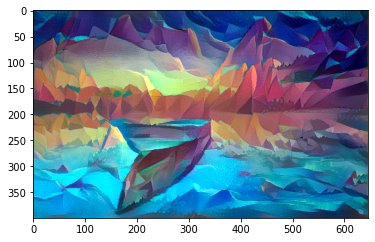

Image saved as:  my_result_at_iteration_420.png
Iteration 420 completed in 5s
Start of iteration:  421
Current loss:  131740200.0
Iteration 421 completed in 4s
Start of iteration:  422
Current loss:  131638690.0
Iteration 422 completed in 4s
Start of iteration:  423
Current loss:  131548010.0
Iteration 423 completed in 4s
Start of iteration:  424
Current loss:  131425570.0
Iteration 424 completed in 4s
Start of iteration:  425
Current loss:  131313610.0
Iteration 425 completed in 4s
Start of iteration:  426
Current loss:  131209630.0
Iteration 426 completed in 4s
Start of iteration:  427
Current loss:  131114310.0
Iteration 427 completed in 4s
Start of iteration:  428
Current loss:  130986780.0
Iteration 428 completed in 4s
Start of iteration:  429
Current loss:  130869890.0
Iteration 429 completed in 4s
Start of iteration:  430
Current loss:  130767110.0


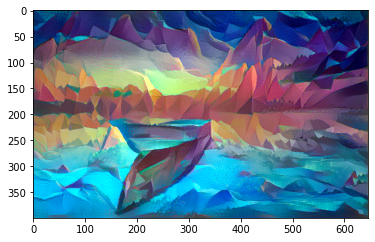

Image saved as:  my_result_at_iteration_430.png
Iteration 430 completed in 5s
Start of iteration:  431
Current loss:  130660360.0
Iteration 431 completed in 4s
Start of iteration:  432
Current loss:  130560010.0
Iteration 432 completed in 4s
Start of iteration:  433
Current loss:  130454370.0
Iteration 433 completed in 5s
Start of iteration:  434
Current loss:  130330904.0
Iteration 434 completed in 4s
Start of iteration:  435
Current loss:  130235550.0
Iteration 435 completed in 4s
Start of iteration:  436
Current loss:  130120710.0
Iteration 436 completed in 5s
Start of iteration:  437
Current loss:  130016730.0
Iteration 437 completed in 4s
Start of iteration:  438
Current loss:  129911360.0
Iteration 438 completed in 4s
Start of iteration:  439
Current loss:  129803400.0
Iteration 439 completed in 5s
Start of iteration:  440
Current loss:  129691490.0


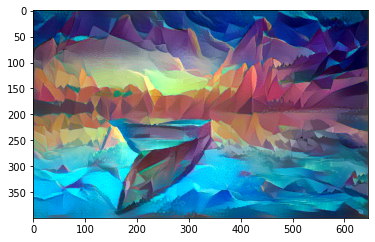

Image saved as:  my_result_at_iteration_440.png
Iteration 440 completed in 5s
Start of iteration:  441
Current loss:  129573540.0
Iteration 441 completed in 4s
Start of iteration:  442
Current loss:  129453944.0
Iteration 442 completed in 4s
Start of iteration:  443
Current loss:  129343770.0
Iteration 443 completed in 4s
Start of iteration:  444
Current loss:  129226150.0
Iteration 444 completed in 4s
Start of iteration:  445
Current loss:  129136920.0
Iteration 445 completed in 4s
Start of iteration:  446
Current loss:  129029090.0
Iteration 446 completed in 5s
Start of iteration:  447
Current loss:  128918410.0
Iteration 447 completed in 4s
Start of iteration:  448
Current loss:  128815544.0
Iteration 448 completed in 5s
Start of iteration:  449
Current loss:  128725130.0
Iteration 449 completed in 4s
Start of iteration:  450
Current loss:  128627100.0


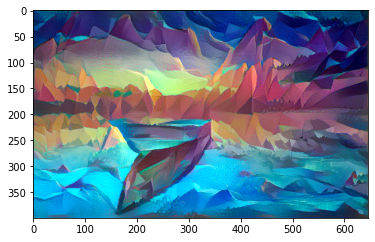

Image saved as:  my_result_at_iteration_450.png
Iteration 450 completed in 5s
Start of iteration:  451
Current loss:  128547630.0
Iteration 451 completed in 4s
Start of iteration:  452
Current loss:  128459300.0
Iteration 452 completed in 4s
Start of iteration:  453
Current loss:  128366540.0
Iteration 453 completed in 4s
Start of iteration:  454
Current loss:  128268770.0
Iteration 454 completed in 4s
Start of iteration:  455
Current loss:  128168600.0
Iteration 455 completed in 4s
Start of iteration:  456
Current loss:  128087120.0
Iteration 456 completed in 4s
Start of iteration:  457
Current loss:  127969380.0
Iteration 457 completed in 4s
Start of iteration:  458
Current loss:  127851870.0
Iteration 458 completed in 4s
Start of iteration:  459
Current loss:  127690100.0
Iteration 459 completed in 4s
Start of iteration:  460
Current loss:  127597770.0


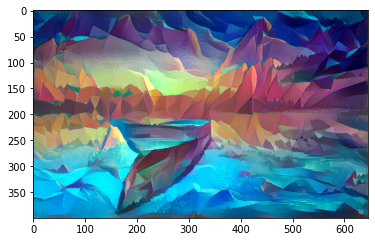

Image saved as:  my_result_at_iteration_460.png
Iteration 460 completed in 5s
Start of iteration:  461
Current loss:  127508040.0
Iteration 461 completed in 4s
Start of iteration:  462
Current loss:  127404104.0
Iteration 462 completed in 4s
Start of iteration:  463
Current loss:  127289720.0
Iteration 463 completed in 4s
Start of iteration:  464
Current loss:  127199430.0
Iteration 464 completed in 4s
Start of iteration:  465
Current loss:  127099440.0
Iteration 465 completed in 4s
Start of iteration:  466
Current loss:  127009360.0
Iteration 466 completed in 4s
Start of iteration:  467
Current loss:  126885130.0
Iteration 467 completed in 4s
Start of iteration:  468
Current loss:  126788856.0
Iteration 468 completed in 4s
Start of iteration:  469
Current loss:  126690880.0
Iteration 469 completed in 4s
Start of iteration:  470
Current loss:  126593220.0


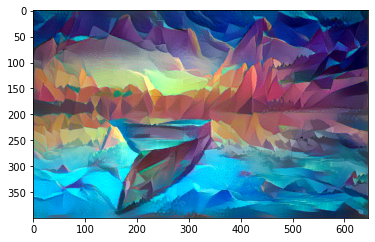

Image saved as:  my_result_at_iteration_470.png
Iteration 470 completed in 5s
Start of iteration:  471
Current loss:  126437240.0
Iteration 471 completed in 4s
Start of iteration:  472
Current loss:  126352560.0
Iteration 472 completed in 4s
Start of iteration:  473
Current loss:  126254720.0
Iteration 473 completed in 4s
Start of iteration:  474
Current loss:  126170050.0
Iteration 474 completed in 4s
Start of iteration:  475
Current loss:  126079770.0
Iteration 475 completed in 4s
Start of iteration:  476
Current loss:  125998180.0
Iteration 476 completed in 4s
Start of iteration:  477
Current loss:  125884970.0
Iteration 477 completed in 4s
Start of iteration:  478
Current loss:  125757096.0
Iteration 478 completed in 4s
Start of iteration:  479
Current loss:  125631790.0
Iteration 479 completed in 4s
Start of iteration:  480
Current loss:  125510500.0


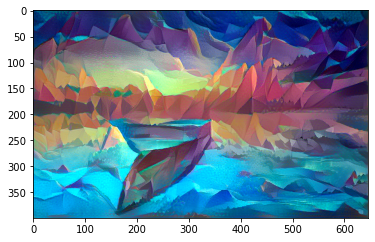

Image saved as:  my_result_at_iteration_480.png
Iteration 480 completed in 5s
Start of iteration:  481
Current loss:  125410300.0
Iteration 481 completed in 4s
Start of iteration:  482
Current loss:  125304680.0
Iteration 482 completed in 4s
Start of iteration:  483
Current loss:  125205624.0
Iteration 483 completed in 4s
Start of iteration:  484
Current loss:  125077220.0
Iteration 484 completed in 5s
Start of iteration:  485
Current loss:  124972670.0
Iteration 485 completed in 4s
Start of iteration:  486
Current loss:  124865330.0
Iteration 486 completed in 4s
Start of iteration:  487
Current loss:  124766140.0
Iteration 487 completed in 4s
Start of iteration:  488
Current loss:  124655176.0
Iteration 488 completed in 4s
Start of iteration:  489
Current loss:  124564040.0
Iteration 489 completed in 4s
Start of iteration:  490
Current loss:  124448900.0


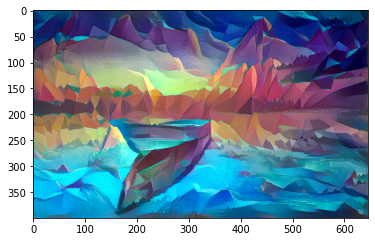

Image saved as:  my_result_at_iteration_490.png
Iteration 490 completed in 5s
Start of iteration:  491
Current loss:  124371944.0
Iteration 491 completed in 5s
Start of iteration:  492
Current loss:  124280190.0
Iteration 492 completed in 4s
Start of iteration:  493
Current loss:  124204290.0
Iteration 493 completed in 4s
Start of iteration:  494
Current loss:  124128700.0
Iteration 494 completed in 4s
Start of iteration:  495
Current loss:  124052130.0
Iteration 495 completed in 4s
Start of iteration:  496
Current loss:  123978630.0
Iteration 496 completed in 4s
Start of iteration:  497
Current loss:  123877280.0
Iteration 497 completed in 4s
Start of iteration:  498
Current loss:  123803920.0
Iteration 498 completed in 4s
Start of iteration:  499
Current loss:  123697600.0
Iteration 499 completed in 4s
Start of iteration:  500
Current loss:  123612590.0


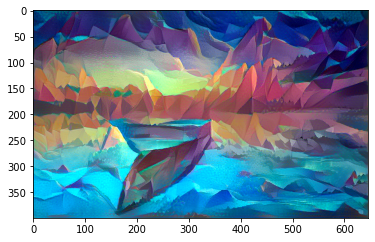

Image saved as:  my_result_at_iteration_500.png
Iteration 500 completed in 5s
Start of iteration:  501
Current loss:  123512360.0
Iteration 501 completed in 4s
Start of iteration:  502
Current loss:  123408590.0
Iteration 502 completed in 4s
Start of iteration:  503
Current loss:  123264240.0
Iteration 503 completed in 5s
Start of iteration:  504
Current loss:  123181760.0
Iteration 504 completed in 4s
Start of iteration:  505
Current loss:  123103550.0
Iteration 505 completed in 4s
Start of iteration:  506
Current loss:  123014720.0
Iteration 506 completed in 4s
Start of iteration:  507
Current loss:  122928240.0
Iteration 507 completed in 4s
Start of iteration:  508
Current loss:  122827090.0
Iteration 508 completed in 4s
Start of iteration:  509
Current loss:  122709300.0
Iteration 509 completed in 5s
Start of iteration:  510
Current loss:  122625240.0


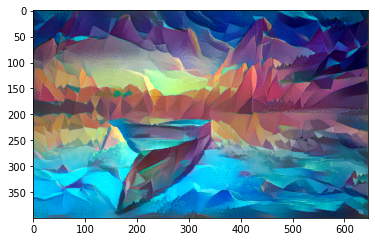

Image saved as:  my_result_at_iteration_510.png
Iteration 510 completed in 5s
Start of iteration:  511
Current loss:  122529300.0
Iteration 511 completed in 4s
Start of iteration:  512
Current loss:  122446190.0
Iteration 512 completed in 4s
Start of iteration:  513
Current loss:  122368730.0
Iteration 513 completed in 4s
Start of iteration:  514
Current loss:  122290340.0
Iteration 514 completed in 4s
Start of iteration:  515
Current loss:  122216530.0
Iteration 515 completed in 4s
Start of iteration:  516
Current loss:  122148780.0
Iteration 516 completed in 4s
Start of iteration:  517
Current loss:  122050000.0
Iteration 517 completed in 4s
Start of iteration:  518
Current loss:  121962160.0
Iteration 518 completed in 4s
Start of iteration:  519
Current loss:  121871080.0
Iteration 519 completed in 4s
Start of iteration:  520
Current loss:  121801290.0


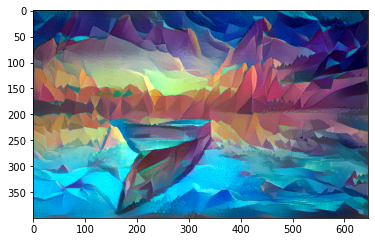

Image saved as:  my_result_at_iteration_520.png
Iteration 520 completed in 5s
Start of iteration:  521
Current loss:  121719784.0
Iteration 521 completed in 4s
Start of iteration:  522
Current loss:  121646240.0
Iteration 522 completed in 4s
Start of iteration:  523
Current loss:  121564650.0
Iteration 523 completed in 4s
Start of iteration:  524
Current loss:  121466900.0
Iteration 524 completed in 4s
Start of iteration:  525
Current loss:  121389850.0
Iteration 525 completed in 4s
Start of iteration:  526
Current loss:  121303784.0
Iteration 526 completed in 4s
Start of iteration:  527
Current loss:  121219190.0
Iteration 527 completed in 4s
Start of iteration:  528
Current loss:  121131680.0
Iteration 528 completed in 4s
Start of iteration:  529
Current loss:  120972510.0
Iteration 529 completed in 4s
Start of iteration:  530
Current loss:  120771784.0


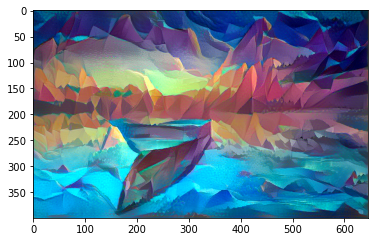

Image saved as:  my_result_at_iteration_530.png
Iteration 530 completed in 5s
Start of iteration:  531
Current loss:  120691690.0
Iteration 531 completed in 4s
Start of iteration:  532
Current loss:  120624030.0
Iteration 532 completed in 4s
Start of iteration:  533
Current loss:  120560190.0
Iteration 533 completed in 4s
Start of iteration:  534
Current loss:  120480960.0
Iteration 534 completed in 4s
Start of iteration:  535
Current loss:  120404660.0
Iteration 535 completed in 4s
Start of iteration:  536
Current loss:  120326380.0
Iteration 536 completed in 4s
Start of iteration:  537
Current loss:  120233020.0
Iteration 537 completed in 4s
Start of iteration:  538
Current loss:  120155144.0
Iteration 538 completed in 4s
Start of iteration:  539
Current loss:  120070370.0
Iteration 539 completed in 4s
Start of iteration:  540
Current loss:  119982420.0


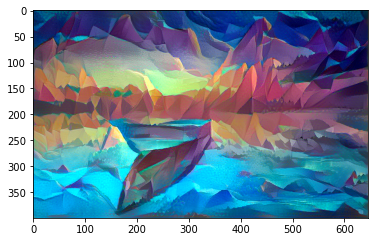

Image saved as:  my_result_at_iteration_540.png
Iteration 540 completed in 5s
Start of iteration:  541
Current loss:  119856690.0
Iteration 541 completed in 4s
Start of iteration:  542
Current loss:  119783130.0
Iteration 542 completed in 4s
Start of iteration:  543
Current loss:  119697920.0
Iteration 543 completed in 4s
Start of iteration:  544
Current loss:  119623400.0
Iteration 544 completed in 4s
Start of iteration:  545
Current loss:  119553896.0
Iteration 545 completed in 4s
Start of iteration:  546
Current loss:  119481350.0
Iteration 546 completed in 4s
Start of iteration:  547
Current loss:  119402424.0
Iteration 547 completed in 4s
Start of iteration:  548
Current loss:  119332960.0
Iteration 548 completed in 4s
Start of iteration:  549
Current loss:  119239736.0
Iteration 549 completed in 4s
Start of iteration:  550
Current loss:  119175610.0


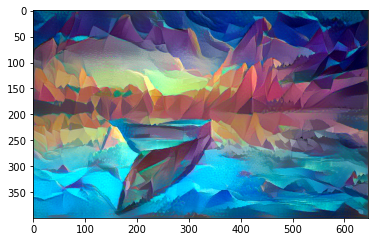

Image saved as:  my_result_at_iteration_550.png
Iteration 550 completed in 5s
Start of iteration:  551
Current loss:  119095500.0
Iteration 551 completed in 4s
Start of iteration:  552
Current loss:  119037210.0
Iteration 552 completed in 4s
Start of iteration:  553
Current loss:  118965360.0
Iteration 553 completed in 4s
Start of iteration:  554
Current loss:  118898136.0
Iteration 554 completed in 4s
Start of iteration:  555
Current loss:  118821336.0
Iteration 555 completed in 4s
Start of iteration:  556
Current loss:  118757360.0
Iteration 556 completed in 4s
Start of iteration:  557
Current loss:  118680540.0
Iteration 557 completed in 4s
Start of iteration:  558
Current loss:  118622950.0
Iteration 558 completed in 4s
Start of iteration:  559
Current loss:  118545576.0
Iteration 559 completed in 4s
Start of iteration:  560
Current loss:  118483550.0


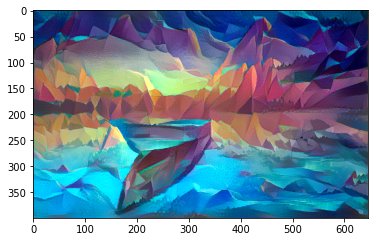

Image saved as:  my_result_at_iteration_560.png
Iteration 560 completed in 5s
Start of iteration:  561
Current loss:  118408120.0
Iteration 561 completed in 4s
Start of iteration:  562
Current loss:  118315050.0
Iteration 562 completed in 4s
Start of iteration:  563
Current loss:  118181256.0
Iteration 563 completed in 4s
Start of iteration:  564
Current loss:  118112130.0
Iteration 564 completed in 4s
Start of iteration:  565
Current loss:  118046450.0
Iteration 565 completed in 4s
Start of iteration:  566
Current loss:  117971770.0
Iteration 566 completed in 4s
Start of iteration:  567
Current loss:  117900680.0
Iteration 567 completed in 4s
Start of iteration:  568
Current loss:  117830320.0
Iteration 568 completed in 4s
Start of iteration:  569
Current loss:  117763430.0
Iteration 569 completed in 4s
Start of iteration:  570
Current loss:  117702824.0


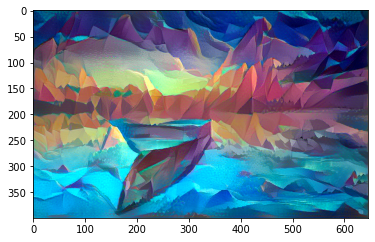

Image saved as:  my_result_at_iteration_570.png
Iteration 570 completed in 5s
Start of iteration:  571
Current loss:  117643150.0
Iteration 571 completed in 4s
Start of iteration:  572
Current loss:  117519810.0
Iteration 572 completed in 4s
Start of iteration:  573
Current loss:  117397700.0
Iteration 573 completed in 4s
Start of iteration:  574
Current loss:  117308504.0
Iteration 574 completed in 4s
Start of iteration:  575
Current loss:  117226370.0
Iteration 575 completed in 4s
Start of iteration:  576
Current loss:  117163660.0
Iteration 576 completed in 4s
Start of iteration:  577
Current loss:  117099784.0
Iteration 577 completed in 4s
Start of iteration:  578
Current loss:  117033740.0
Iteration 578 completed in 4s
Start of iteration:  579
Current loss:  116964690.0
Iteration 579 completed in 4s
Start of iteration:  580
Current loss:  116907860.0


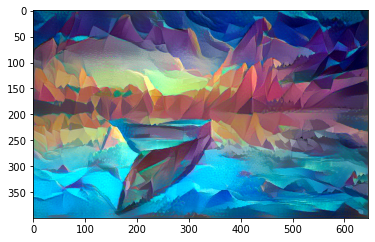

Image saved as:  my_result_at_iteration_580.png
Iteration 580 completed in 5s
Start of iteration:  581
Current loss:  116841336.0
Iteration 581 completed in 4s
Start of iteration:  582
Current loss:  116779896.0
Iteration 582 completed in 4s
Start of iteration:  583
Current loss:  116700850.0
Iteration 583 completed in 5s
Start of iteration:  584
Current loss:  116631890.0
Iteration 584 completed in 4s
Start of iteration:  585
Current loss:  116572870.0
Iteration 585 completed in 4s
Start of iteration:  586
Current loss:  116509840.0
Iteration 586 completed in 4s
Start of iteration:  587
Current loss:  116450720.0
Iteration 587 completed in 4s
Start of iteration:  588
Current loss:  116378840.0
Iteration 588 completed in 4s
Start of iteration:  589
Current loss:  116320620.0
Iteration 589 completed in 4s
Start of iteration:  590
Current loss:  116255110.0


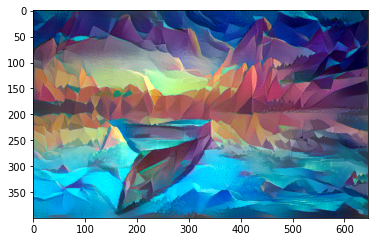

Image saved as:  my_result_at_iteration_590.png
Iteration 590 completed in 5s
Start of iteration:  591
Current loss:  116192984.0
Iteration 591 completed in 4s
Start of iteration:  592
Current loss:  116129660.0
Iteration 592 completed in 4s
Start of iteration:  593
Current loss:  116077050.0
Iteration 593 completed in 4s
Start of iteration:  594
Current loss:  116020520.0
Iteration 594 completed in 4s
Start of iteration:  595
Current loss:  115963520.0
Iteration 595 completed in 4s
Start of iteration:  596
Current loss:  115899224.0
Iteration 596 completed in 4s
Start of iteration:  597
Current loss:  115835470.0
Iteration 597 completed in 4s
Start of iteration:  598
Current loss:  115761900.0
Iteration 598 completed in 4s
Start of iteration:  599
Current loss:  115684730.0
Iteration 599 completed in 4s
Start of iteration:  600
Current loss:  115592560.0


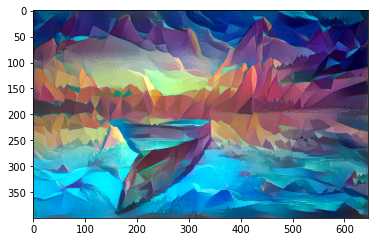

Image saved as:  my_result_at_iteration_600.png
Iteration 600 completed in 5s
Start of iteration:  601
Current loss:  115459416.0
Iteration 601 completed in 5s
Start of iteration:  602
Current loss:  115325330.0
Iteration 602 completed in 4s
Start of iteration:  603
Current loss:  115233496.0
Iteration 603 completed in 4s
Start of iteration:  604
Current loss:  115166620.0
Iteration 604 completed in 4s
Start of iteration:  605
Current loss:  115113570.0
Iteration 605 completed in 4s
Start of iteration:  606
Current loss:  115064410.0
Iteration 606 completed in 4s
Start of iteration:  607
Current loss:  115005320.0
Iteration 607 completed in 4s
Start of iteration:  608
Current loss:  114942610.0
Iteration 608 completed in 4s
Start of iteration:  609
Current loss:  114869430.0
Iteration 609 completed in 4s
Start of iteration:  610
Current loss:  114801176.0


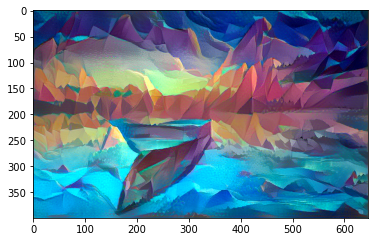

Image saved as:  my_result_at_iteration_610.png
Iteration 610 completed in 5s
Start of iteration:  611
Current loss:  114716330.0
Iteration 611 completed in 4s
Start of iteration:  612
Current loss:  114641370.0
Iteration 612 completed in 4s
Start of iteration:  613
Current loss:  114541270.0
Iteration 613 completed in 4s
Start of iteration:  614
Current loss:  114481160.0
Iteration 614 completed in 4s
Start of iteration:  615
Current loss:  114410370.0
Iteration 615 completed in 4s
Start of iteration:  616
Current loss:  114360420.0
Iteration 616 completed in 4s
Start of iteration:  617
Current loss:  114301624.0
Iteration 617 completed in 4s
Start of iteration:  618
Current loss:  114248380.0
Iteration 618 completed in 4s
Start of iteration:  619
Current loss:  114181600.0
Iteration 619 completed in 4s
Start of iteration:  620
Current loss:  114119670.0


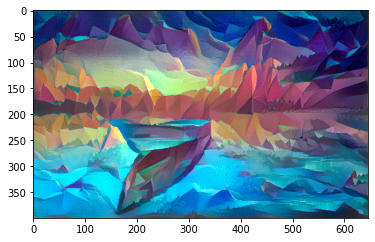

Image saved as:  my_result_at_iteration_620.png
Iteration 620 completed in 5s
Start of iteration:  621
Current loss:  114059750.0
Iteration 621 completed in 4s
Start of iteration:  622
Current loss:  114004760.0
Iteration 622 completed in 4s
Start of iteration:  623
Current loss:  113948216.0
Iteration 623 completed in 4s
Start of iteration:  624
Current loss:  113895210.0
Iteration 624 completed in 5s
Start of iteration:  625
Current loss:  113832970.0
Iteration 625 completed in 4s
Start of iteration:  626
Current loss:  113730536.0
Iteration 626 completed in 4s
Start of iteration:  627
Current loss:  113634790.0
Iteration 627 completed in 4s
Start of iteration:  628
Current loss:  113567810.0
Iteration 628 completed in 4s
Start of iteration:  629
Current loss:  113494936.0
Iteration 629 completed in 4s
Start of iteration:  630
Current loss:  113434744.0


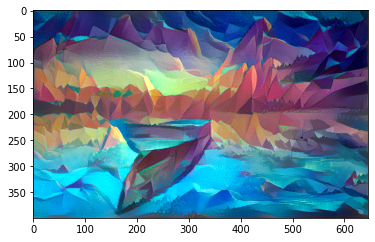

Image saved as:  my_result_at_iteration_630.png
Iteration 630 completed in 5s
Start of iteration:  631
Current loss:  113370710.0
Iteration 631 completed in 4s
Start of iteration:  632
Current loss:  113319850.0
Iteration 632 completed in 4s
Start of iteration:  633
Current loss:  113260296.0
Iteration 633 completed in 4s
Start of iteration:  634
Current loss:  113204024.0
Iteration 634 completed in 4s
Start of iteration:  635
Current loss:  113147656.0
Iteration 635 completed in 4s
Start of iteration:  636
Current loss:  113096870.0
Iteration 636 completed in 5s
Start of iteration:  637
Current loss:  113043510.0
Iteration 637 completed in 4s
Start of iteration:  638
Current loss:  112979950.0
Iteration 638 completed in 4s
Start of iteration:  639
Current loss:  112911360.0
Iteration 639 completed in 4s
Start of iteration:  640
Current loss:  112815230.0


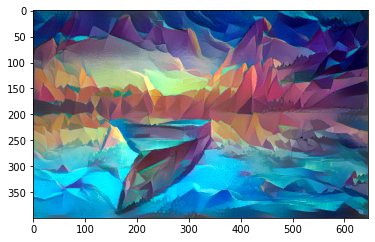

Image saved as:  my_result_at_iteration_640.png
Iteration 640 completed in 5s
Start of iteration:  641
Current loss:  112694904.0
Iteration 641 completed in 4s
Start of iteration:  642
Current loss:  112632690.0
Iteration 642 completed in 4s
Start of iteration:  643
Current loss:  112574400.0
Iteration 643 completed in 4s
Start of iteration:  644
Current loss:  112532250.0
Iteration 644 completed in 4s
Start of iteration:  645
Current loss:  112478000.0
Iteration 645 completed in 4s
Start of iteration:  646
Current loss:  112427816.0
Iteration 646 completed in 4s
Start of iteration:  647
Current loss:  112371270.0
Iteration 647 completed in 4s
Start of iteration:  648
Current loss:  112310960.0
Iteration 648 completed in 4s
Start of iteration:  649
Current loss:  112245710.0
Iteration 649 completed in 5s
Start of iteration:  650
Current loss:  112168700.0


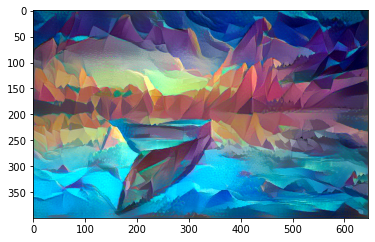

Image saved as:  my_result_at_iteration_650.png
Iteration 650 completed in 5s
Start of iteration:  651
Current loss:  112120240.0
Iteration 651 completed in 4s
Start of iteration:  652
Current loss:  112054480.0
Iteration 652 completed in 4s
Start of iteration:  653
Current loss:  111999800.0
Iteration 653 completed in 4s
Start of iteration:  654
Current loss:  111941780.0
Iteration 654 completed in 4s
Start of iteration:  655
Current loss:  111891976.0
Iteration 655 completed in 4s
Start of iteration:  656
Current loss:  111829020.0
Iteration 656 completed in 4s
Start of iteration:  657
Current loss:  111780590.0
Iteration 657 completed in 4s
Start of iteration:  658
Current loss:  111717610.0
Iteration 658 completed in 4s
Start of iteration:  659
Current loss:  111655230.0
Iteration 659 completed in 4s
Start of iteration:  660
Current loss:  111575576.0


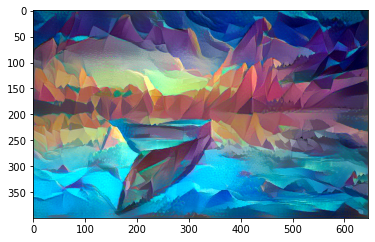

Image saved as:  my_result_at_iteration_660.png
Iteration 660 completed in 5s
Start of iteration:  661
Current loss:  111524856.0
Iteration 661 completed in 4s
Start of iteration:  662
Current loss:  111456536.0
Iteration 662 completed in 4s
Start of iteration:  663
Current loss:  111398600.0
Iteration 663 completed in 4s
Start of iteration:  664
Current loss:  111322460.0
Iteration 664 completed in 4s
Start of iteration:  665
Current loss:  111254900.0
Iteration 665 completed in 4s
Start of iteration:  666
Current loss:  111186940.0
Iteration 666 completed in 4s
Start of iteration:  667
Current loss:  111134890.0
Iteration 667 completed in 4s
Start of iteration:  668
Current loss:  111084600.0
Iteration 668 completed in 4s
Start of iteration:  669
Current loss:  111034320.0
Iteration 669 completed in 4s
Start of iteration:  670
Current loss:  110971960.0


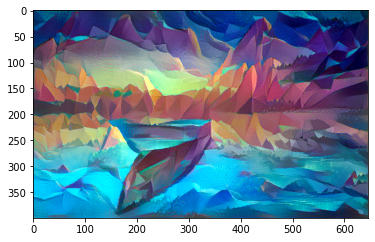

Image saved as:  my_result_at_iteration_670.png
Iteration 670 completed in 5s
Start of iteration:  671
Current loss:  110912824.0
Iteration 671 completed in 4s
Start of iteration:  672
Current loss:  110844610.0
Iteration 672 completed in 4s
Start of iteration:  673
Current loss:  110794570.0
Iteration 673 completed in 4s
Start of iteration:  674
Current loss:  110735464.0
Iteration 674 completed in 4s
Start of iteration:  675
Current loss:  110690100.0
Iteration 675 completed in 4s
Start of iteration:  676
Current loss:  110640696.0
Iteration 676 completed in 4s
Start of iteration:  677
Current loss:  110583820.0
Iteration 677 completed in 4s
Start of iteration:  678
Current loss:  110528696.0
Iteration 678 completed in 4s
Start of iteration:  679
Current loss:  110480780.0
Iteration 679 completed in 4s
Start of iteration:  680
Current loss:  110430290.0


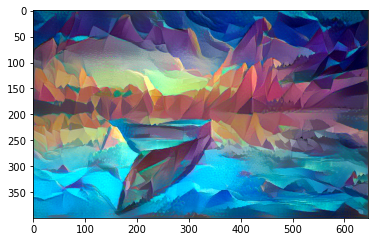

Image saved as:  my_result_at_iteration_680.png
Iteration 680 completed in 5s
Start of iteration:  681
Current loss:  110342530.0
Iteration 681 completed in 4s
Start of iteration:  682
Current loss:  110242540.0
Iteration 682 completed in 4s
Start of iteration:  683
Current loss:  110194450.0
Iteration 683 completed in 4s
Start of iteration:  684
Current loss:  110142210.0
Iteration 684 completed in 4s
Start of iteration:  685
Current loss:  110086200.0
Iteration 685 completed in 4s
Start of iteration:  686
Current loss:  110018360.0
Iteration 686 completed in 4s
Start of iteration:  687
Current loss:  109967160.0
Iteration 687 completed in 5s
Start of iteration:  688
Current loss:  109912904.0
Iteration 688 completed in 4s
Start of iteration:  689
Current loss:  109845930.0
Iteration 689 completed in 4s
Start of iteration:  690
Current loss:  109747624.0


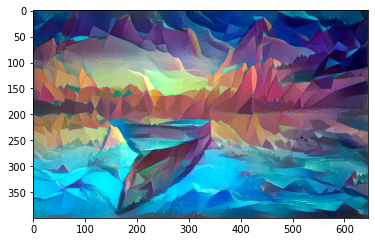

Image saved as:  my_result_at_iteration_690.png
Iteration 690 completed in 5s
Start of iteration:  691
Current loss:  109697544.0
Iteration 691 completed in 4s
Start of iteration:  692
Current loss:  109645490.0
Iteration 692 completed in 4s
Start of iteration:  693
Current loss:  109607600.0
Iteration 693 completed in 4s
Start of iteration:  694
Current loss:  109560810.0
Iteration 694 completed in 4s
Start of iteration:  695
Current loss:  109515120.0
Iteration 695 completed in 4s
Start of iteration:  696
Current loss:  109462240.0
Iteration 696 completed in 4s
Start of iteration:  697
Current loss:  109415464.0
Iteration 697 completed in 4s
Start of iteration:  698
Current loss:  109364824.0
Iteration 698 completed in 4s
Start of iteration:  699
Current loss:  109319336.0
Iteration 699 completed in 4s
Start of iteration:  700
Current loss:  109267790.0


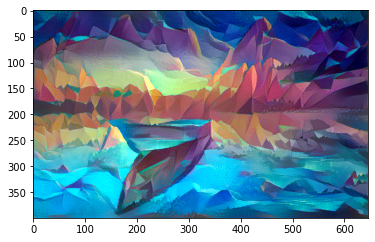

Image saved as:  my_result_at_iteration_700.png
Iteration 700 completed in 5s
Start of iteration:  701
Current loss:  109220450.0
Iteration 701 completed in 4s
Start of iteration:  702
Current loss:  109165230.0
Iteration 702 completed in 4s
Start of iteration:  703
Current loss:  109124300.0
Iteration 703 completed in 4s
Start of iteration:  704
Current loss:  109078984.0
Iteration 704 completed in 4s
Start of iteration:  705
Current loss:  109029380.0
Iteration 705 completed in 4s
Start of iteration:  706
Current loss:  108954140.0
Iteration 706 completed in 4s
Start of iteration:  707
Current loss:  108899860.0
Iteration 707 completed in 4s
Start of iteration:  708
Current loss:  108838890.0
Iteration 708 completed in 4s
Start of iteration:  709
Current loss:  108777690.0
Iteration 709 completed in 4s
Start of iteration:  710
Current loss:  108716510.0


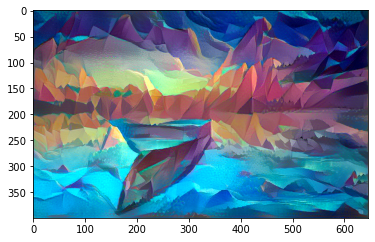

Image saved as:  my_result_at_iteration_710.png
Iteration 710 completed in 5s
Start of iteration:  711
Current loss:  108667150.0
Iteration 711 completed in 4s
Start of iteration:  712
Current loss:  108614216.0
Iteration 712 completed in 4s
Start of iteration:  713
Current loss:  108577490.0
Iteration 713 completed in 4s
Start of iteration:  714
Current loss:  108540000.0
Iteration 714 completed in 4s
Start of iteration:  715
Current loss:  108499290.0
Iteration 715 completed in 4s
Start of iteration:  716
Current loss:  108447450.0
Iteration 716 completed in 4s
Start of iteration:  717
Current loss:  108390000.0
Iteration 717 completed in 4s
Start of iteration:  718
Current loss:  108341710.0
Iteration 718 completed in 4s
Start of iteration:  719
Current loss:  108271256.0
Iteration 719 completed in 4s
Start of iteration:  720
Current loss:  108225380.0


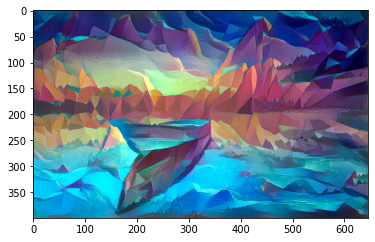

Image saved as:  my_result_at_iteration_720.png
Iteration 720 completed in 5s
Start of iteration:  721
Current loss:  108180780.0
Iteration 721 completed in 5s
Start of iteration:  722
Current loss:  108110180.0
Iteration 722 completed in 4s
Start of iteration:  723
Current loss:  108006260.0
Iteration 723 completed in 4s
Start of iteration:  724
Current loss:  107962616.0
Iteration 724 completed in 4s
Start of iteration:  725
Current loss:  107921130.0
Iteration 725 completed in 4s
Start of iteration:  726
Current loss:  107886710.0
Iteration 726 completed in 4s
Start of iteration:  727
Current loss:  107844970.0
Iteration 727 completed in 4s
Start of iteration:  728
Current loss:  107806720.0
Iteration 728 completed in 4s
Start of iteration:  729
Current loss:  107762310.0
Iteration 729 completed in 4s
Start of iteration:  730
Current loss:  107716010.0


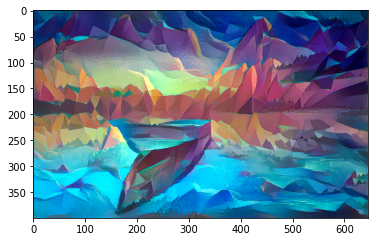

Image saved as:  my_result_at_iteration_730.png
Iteration 730 completed in 5s
Start of iteration:  731
Current loss:  107675360.0
Iteration 731 completed in 4s
Start of iteration:  732
Current loss:  107629370.0
Iteration 732 completed in 4s
Start of iteration:  733
Current loss:  107580860.0
Iteration 733 completed in 4s
Start of iteration:  734
Current loss:  107529380.0
Iteration 734 completed in 5s
Start of iteration:  735
Current loss:  107481330.0
Iteration 735 completed in 4s
Start of iteration:  736
Current loss:  107418740.0
Iteration 736 completed in 4s
Start of iteration:  737
Current loss:  107375660.0
Iteration 737 completed in 4s
Start of iteration:  738
Current loss:  107321050.0
Iteration 738 completed in 4s
Start of iteration:  739
Current loss:  107274100.0
Iteration 739 completed in 4s
Start of iteration:  740
Current loss:  107224330.0


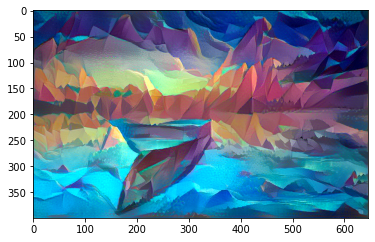

Image saved as:  my_result_at_iteration_740.png
Iteration 740 completed in 5s
Start of iteration:  741
Current loss:  107177560.0
Iteration 741 completed in 4s
Start of iteration:  742
Current loss:  107130210.0
Iteration 742 completed in 4s
Start of iteration:  743
Current loss:  107086670.0
Iteration 743 completed in 4s
Start of iteration:  744
Current loss:  107037736.0
Iteration 744 completed in 4s
Start of iteration:  745
Current loss:  106993096.0
Iteration 745 completed in 4s
Start of iteration:  746
Current loss:  106945450.0
Iteration 746 completed in 4s
Start of iteration:  747
Current loss:  106900424.0
Iteration 747 completed in 4s
Start of iteration:  748
Current loss:  106844410.0
Iteration 748 completed in 4s
Start of iteration:  749
Current loss:  106795224.0
Iteration 749 completed in 4s
Start of iteration:  750
Current loss:  106748050.0


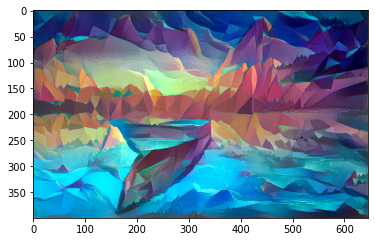

Image saved as:  my_result_at_iteration_750.png
Iteration 750 completed in 5s
Start of iteration:  751
Current loss:  106710150.0
Iteration 751 completed in 4s
Start of iteration:  752
Current loss:  106668616.0
Iteration 752 completed in 4s
Start of iteration:  753
Current loss:  106630820.0
Iteration 753 completed in 4s
Start of iteration:  754
Current loss:  106590270.0
Iteration 754 completed in 4s
Start of iteration:  755
Current loss:  106553860.0
Iteration 755 completed in 4s
Start of iteration:  756
Current loss:  106519450.0
Iteration 756 completed in 4s
Start of iteration:  757
Current loss:  106481176.0
Iteration 757 completed in 4s
Start of iteration:  758
Current loss:  106446500.0
Iteration 758 completed in 4s
Start of iteration:  759
Current loss:  106406590.0
Iteration 759 completed in 4s
Start of iteration:  760
Current loss:  106368480.0


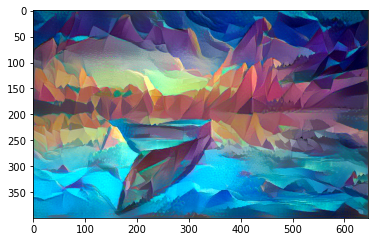

Image saved as:  my_result_at_iteration_760.png
Iteration 760 completed in 5s
Start of iteration:  761
Current loss:  106327500.0
Iteration 761 completed in 5s
Start of iteration:  762
Current loss:  106293120.0
Iteration 762 completed in 4s
Start of iteration:  763
Current loss:  106256640.0
Iteration 763 completed in 4s
Start of iteration:  764
Current loss:  106197930.0
Iteration 764 completed in 4s
Start of iteration:  765
Current loss:  106144050.0
Iteration 765 completed in 4s
Start of iteration:  766
Current loss:  106099224.0
Iteration 766 completed in 4s
Start of iteration:  767
Current loss:  106053200.0
Iteration 767 completed in 4s
Start of iteration:  768
Current loss:  106018000.0
Iteration 768 completed in 4s
Start of iteration:  769
Current loss:  105975496.0
Iteration 769 completed in 4s
Start of iteration:  770
Current loss:  105936430.0


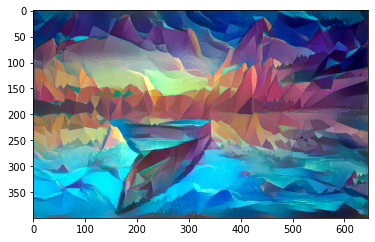

Image saved as:  my_result_at_iteration_770.png
Iteration 770 completed in 5s
Start of iteration:  771
Current loss:  105903870.0
Iteration 771 completed in 4s
Start of iteration:  772
Current loss:  105869224.0
Iteration 772 completed in 4s
Start of iteration:  773
Current loss:  105835704.0
Iteration 773 completed in 4s
Start of iteration:  774
Current loss:  105800590.0
Iteration 774 completed in 4s
Start of iteration:  775
Current loss:  105757180.0
Iteration 775 completed in 4s
Start of iteration:  776
Current loss:  105721256.0
Iteration 776 completed in 4s
Start of iteration:  777
Current loss:  105683304.0
Iteration 777 completed in 5s
Start of iteration:  778
Current loss:  105641864.0
Iteration 778 completed in 4s
Start of iteration:  779
Current loss:  105605096.0
Iteration 779 completed in 4s
Start of iteration:  780
Current loss:  105568910.0


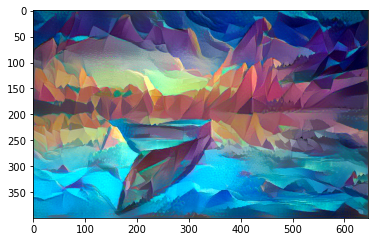

Image saved as:  my_result_at_iteration_780.png
Iteration 780 completed in 5s
Start of iteration:  781
Current loss:  105523810.0
Iteration 781 completed in 4s
Start of iteration:  782
Current loss:  105487630.0
Iteration 782 completed in 4s
Start of iteration:  783
Current loss:  105449470.0
Iteration 783 completed in 4s
Start of iteration:  784
Current loss:  105416200.0
Iteration 784 completed in 4s
Start of iteration:  785
Current loss:  105381640.0
Iteration 785 completed in 4s
Start of iteration:  786
Current loss:  105321580.0
Iteration 786 completed in 4s
Start of iteration:  787
Current loss:  105230410.0
Iteration 787 completed in 4s
Start of iteration:  788
Current loss:  105188870.0
Iteration 788 completed in 4s
Start of iteration:  789
Current loss:  105142850.0
Iteration 789 completed in 4s
Start of iteration:  790
Current loss:  105105580.0


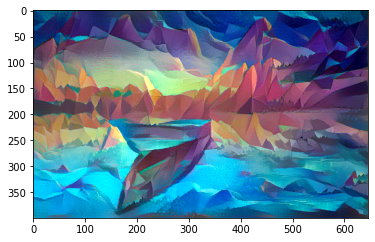

Image saved as:  my_result_at_iteration_790.png
Iteration 790 completed in 5s
Start of iteration:  791
Current loss:  105064420.0
Iteration 791 completed in 4s
Start of iteration:  792
Current loss:  105025070.0
Iteration 792 completed in 4s
Start of iteration:  793
Current loss:  104987060.0
Iteration 793 completed in 4s
Start of iteration:  794
Current loss:  104930300.0
Iteration 794 completed in 4s
Start of iteration:  795
Current loss:  104835410.0
Iteration 795 completed in 4s
Start of iteration:  796
Current loss:  104792920.0
Iteration 796 completed in 4s
Start of iteration:  797
Current loss:  104752570.0
Iteration 797 completed in 4s
Start of iteration:  798
Current loss:  104717700.0
Iteration 798 completed in 4s
Start of iteration:  799
Current loss:  104678024.0
Iteration 799 completed in 4s
Start of iteration:  800
Current loss:  104639700.0


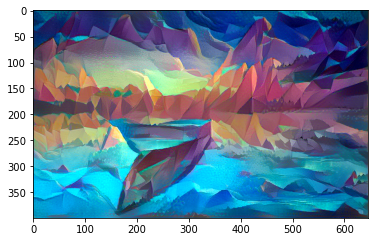

Image saved as:  my_result_at_iteration_800.png
Iteration 800 completed in 5s
Start of iteration:  801
Current loss:  104604230.0
Iteration 801 completed in 4s
Start of iteration:  802
Current loss:  104570700.0
Iteration 802 completed in 4s
Start of iteration:  803
Current loss:  104537240.0
Iteration 803 completed in 4s
Start of iteration:  804
Current loss:  104493070.0
Iteration 804 completed in 4s
Start of iteration:  805
Current loss:  104460050.0
Iteration 805 completed in 4s
Start of iteration:  806
Current loss:  104423820.0
Iteration 806 completed in 4s
Start of iteration:  807
Current loss:  104383100.0
Iteration 807 completed in 4s
Start of iteration:  808
Current loss:  104328860.0
Iteration 808 completed in 4s
Start of iteration:  809
Current loss:  104286480.0
Iteration 809 completed in 4s
Start of iteration:  810
Current loss:  104243810.0


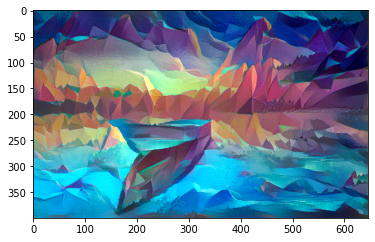

Image saved as:  my_result_at_iteration_810.png
Iteration 810 completed in 5s
Start of iteration:  811
Current loss:  104195150.0
Iteration 811 completed in 4s
Start of iteration:  812
Current loss:  104136010.0
Iteration 812 completed in 4s
Start of iteration:  813
Current loss:  104092550.0
Iteration 813 completed in 4s
Start of iteration:  814
Current loss:  104052696.0
Iteration 814 completed in 4s
Start of iteration:  815
Current loss:  104019350.0
Iteration 815 completed in 4s
Start of iteration:  816
Current loss:  103989280.0
Iteration 816 completed in 4s
Start of iteration:  817
Current loss:  103953200.0
Iteration 817 completed in 4s
Start of iteration:  818
Current loss:  103911440.0
Iteration 818 completed in 4s
Start of iteration:  819
Current loss:  103877930.0
Iteration 819 completed in 4s
Start of iteration:  820
Current loss:  103843340.0


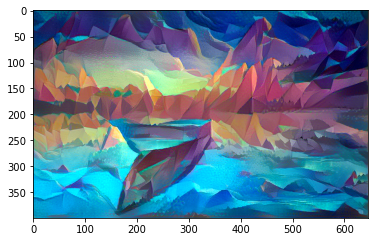

Image saved as:  my_result_at_iteration_820.png
Iteration 820 completed in 5s
Start of iteration:  821
Current loss:  103795580.0
Iteration 821 completed in 4s
Start of iteration:  822
Current loss:  103747190.0
Iteration 822 completed in 5s
Start of iteration:  823
Current loss:  103697064.0
Iteration 823 completed in 4s
Start of iteration:  824
Current loss:  103647570.0
Iteration 824 completed in 4s
Start of iteration:  825
Current loss:  103596080.0
Iteration 825 completed in 4s
Start of iteration:  826
Current loss:  103532350.0
Iteration 826 completed in 4s
Start of iteration:  827
Current loss:  103488920.0
Iteration 827 completed in 4s
Start of iteration:  828
Current loss:  103452770.0
Iteration 828 completed in 4s
Start of iteration:  829
Current loss:  103425470.0
Iteration 829 completed in 4s
Start of iteration:  830
Current loss:  103378900.0


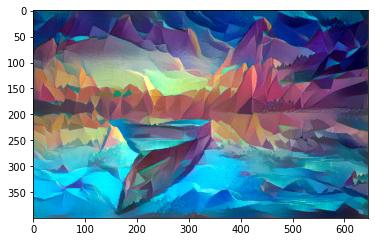

Image saved as:  my_result_at_iteration_830.png
Iteration 830 completed in 5s
Start of iteration:  831
Current loss:  103334340.0
Iteration 831 completed in 4s
Start of iteration:  832
Current loss:  103290940.0
Iteration 832 completed in 4s
Start of iteration:  833
Current loss:  103249720.0
Iteration 833 completed in 4s
Start of iteration:  834
Current loss:  103200230.0
Iteration 834 completed in 4s
Start of iteration:  835
Current loss:  103142480.0
Iteration 835 completed in 4s
Start of iteration:  836
Current loss:  103099160.0
Iteration 836 completed in 4s
Start of iteration:  837
Current loss:  103052744.0
Iteration 837 completed in 4s
Start of iteration:  838
Current loss:  103016584.0
Iteration 838 completed in 4s
Start of iteration:  839
Current loss:  102979000.0
Iteration 839 completed in 4s
Start of iteration:  840
Current loss:  102944480.0


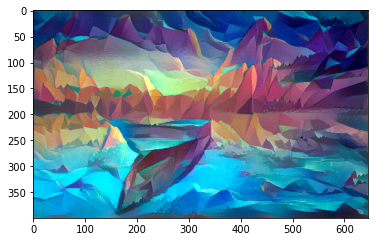

Image saved as:  my_result_at_iteration_840.png
Iteration 840 completed in 5s
Start of iteration:  841
Current loss:  102904710.0
Iteration 841 completed in 5s
Start of iteration:  842
Current loss:  102868420.0
Iteration 842 completed in 4s
Start of iteration:  843
Current loss:  102829660.0
Iteration 843 completed in 4s
Start of iteration:  844
Current loss:  102777624.0
Iteration 844 completed in 4s
Start of iteration:  845
Current loss:  102723220.0
Iteration 845 completed in 4s
Start of iteration:  846
Current loss:  102690860.0
Iteration 846 completed in 4s
Start of iteration:  847
Current loss:  102650390.0
Iteration 847 completed in 4s
Start of iteration:  848
Current loss:  102622110.0
Iteration 848 completed in 4s
Start of iteration:  849
Current loss:  102595530.0
Iteration 849 completed in 4s
Start of iteration:  850
Current loss:  102569580.0


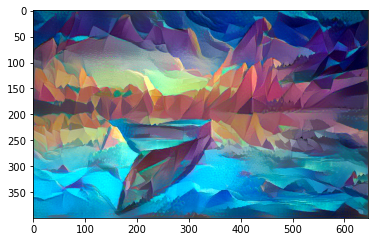

Image saved as:  my_result_at_iteration_850.png
Iteration 850 completed in 5s
Start of iteration:  851
Current loss:  102539896.0
Iteration 851 completed in 4s
Start of iteration:  852
Current loss:  102507000.0
Iteration 852 completed in 4s
Start of iteration:  853
Current loss:  102445940.0
Iteration 853 completed in 4s
Start of iteration:  854
Current loss:  102353900.0
Iteration 854 completed in 4s
Start of iteration:  855
Current loss:  102314860.0
Iteration 855 completed in 4s
Start of iteration:  856
Current loss:  102277640.0
Iteration 856 completed in 5s
Start of iteration:  857
Current loss:  102243050.0
Iteration 857 completed in 4s
Start of iteration:  858
Current loss:  102216960.0
Iteration 858 completed in 4s
Start of iteration:  859
Current loss:  102185270.0
Iteration 859 completed in 4s
Start of iteration:  860
Current loss:  102154540.0


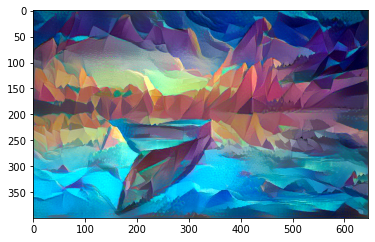

Image saved as:  my_result_at_iteration_860.png
Iteration 860 completed in 5s
Start of iteration:  861
Current loss:  102114630.0
Iteration 861 completed in 4s
Start of iteration:  862
Current loss:  102088260.0
Iteration 862 completed in 4s
Start of iteration:  863
Current loss:  102051290.0
Iteration 863 completed in 4s
Start of iteration:  864
Current loss:  102014630.0
Iteration 864 completed in 4s
Start of iteration:  865
Current loss:  101978216.0
Iteration 865 completed in 4s
Start of iteration:  866
Current loss:  101939540.0
Iteration 866 completed in 4s
Start of iteration:  867
Current loss:  101904800.0
Iteration 867 completed in 4s
Start of iteration:  868
Current loss:  101858930.0
Iteration 868 completed in 4s
Start of iteration:  869
Current loss:  101826220.0
Iteration 869 completed in 4s
Start of iteration:  870
Current loss:  101790680.0


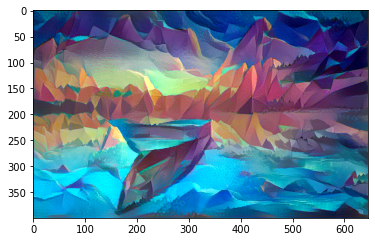

Image saved as:  my_result_at_iteration_870.png
Iteration 870 completed in 5s
Start of iteration:  871
Current loss:  101751064.0
Iteration 871 completed in 5s
Start of iteration:  872
Current loss:  101713580.0
Iteration 872 completed in 4s
Start of iteration:  873
Current loss:  101672330.0
Iteration 873 completed in 4s
Start of iteration:  874
Current loss:  101620776.0
Iteration 874 completed in 4s
Start of iteration:  875
Current loss:  101584200.0
Iteration 875 completed in 4s
Start of iteration:  876
Current loss:  101549016.0
Iteration 876 completed in 4s
Start of iteration:  877
Current loss:  101512300.0
Iteration 877 completed in 4s
Start of iteration:  878
Current loss:  101474130.0
Iteration 878 completed in 4s
Start of iteration:  879
Current loss:  101441624.0
Iteration 879 completed in 4s
Start of iteration:  880
Current loss:  101396980.0


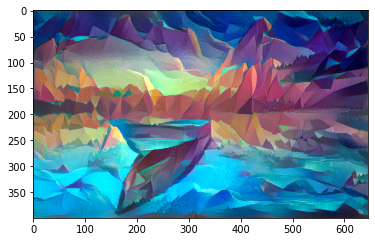

Image saved as:  my_result_at_iteration_880.png
Iteration 880 completed in 5s
Start of iteration:  881
Current loss:  101360664.0
Iteration 881 completed in 4s
Start of iteration:  882
Current loss:  101315720.0
Iteration 882 completed in 4s
Start of iteration:  883
Current loss:  101279590.0
Iteration 883 completed in 4s
Start of iteration:  884
Current loss:  101238936.0
Iteration 884 completed in 4s
Start of iteration:  885
Current loss:  101207336.0
Iteration 885 completed in 4s
Start of iteration:  886
Current loss:  101176740.0
Iteration 886 completed in 4s
Start of iteration:  887
Current loss:  101146110.0
Iteration 887 completed in 4s
Start of iteration:  888
Current loss:  101107920.0
Iteration 888 completed in 4s
Start of iteration:  889
Current loss:  101072480.0
Iteration 889 completed in 4s
Start of iteration:  890
Current loss:  101025520.0


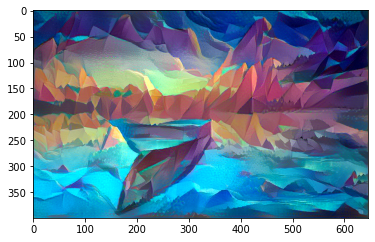

Image saved as:  my_result_at_iteration_890.png
Iteration 890 completed in 5s
Start of iteration:  891
Current loss:  100991600.0
Iteration 891 completed in 4s
Start of iteration:  892
Current loss:  100949620.0
Iteration 892 completed in 4s
Start of iteration:  893
Current loss:  100923900.0
Iteration 893 completed in 4s
Start of iteration:  894
Current loss:  100894940.0
Iteration 894 completed in 4s
Start of iteration:  895
Current loss:  100866420.0
Iteration 895 completed in 4s
Start of iteration:  896
Current loss:  100835650.0
Iteration 896 completed in 4s
Start of iteration:  897
Current loss:  100803336.0
Iteration 897 completed in 4s
Start of iteration:  898
Current loss:  100763770.0
Iteration 898 completed in 4s
Start of iteration:  899
Current loss:  100710410.0
Iteration 899 completed in 4s
Start of iteration:  900
Current loss:  100637350.0


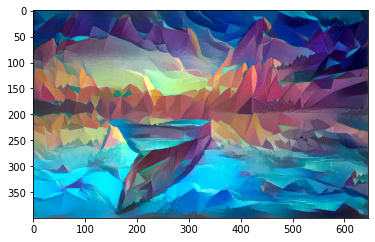

Image saved as:  my_result_at_iteration_900.png
Iteration 900 completed in 5s
Start of iteration:  901
Current loss:  100597600.0
Iteration 901 completed in 4s
Start of iteration:  902
Current loss:  100563624.0
Iteration 902 completed in 4s
Start of iteration:  903
Current loss:  100535180.0
Iteration 903 completed in 4s
Start of iteration:  904
Current loss:  100507370.0
Iteration 904 completed in 4s
Start of iteration:  905
Current loss:  100477130.0
Iteration 905 completed in 4s
Start of iteration:  906
Current loss:  100449310.0
Iteration 906 completed in 4s
Start of iteration:  907
Current loss:  100419830.0
Iteration 907 completed in 4s
Start of iteration:  908
Current loss:  100390110.0
Iteration 908 completed in 4s
Start of iteration:  909
Current loss:  100361330.0
Iteration 909 completed in 4s
Start of iteration:  910
Current loss:  100328930.0


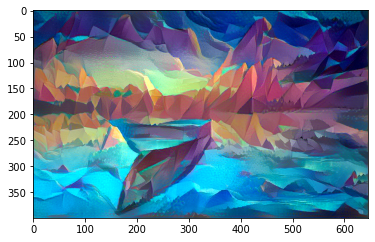

Image saved as:  my_result_at_iteration_910.png
Iteration 910 completed in 5s
Start of iteration:  911
Current loss:  100297000.0
Iteration 911 completed in 4s
Start of iteration:  912
Current loss:  100257440.0
Iteration 912 completed in 4s
Start of iteration:  913
Current loss:  100217330.0
Iteration 913 completed in 4s
Start of iteration:  914
Current loss:  100172850.0
Iteration 914 completed in 4s
Start of iteration:  915
Current loss:  100144376.0
Iteration 915 completed in 4s
Start of iteration:  916
Current loss:  100114670.0
Iteration 916 completed in 4s
Start of iteration:  917
Current loss:  100090160.0
Iteration 917 completed in 4s
Start of iteration:  918
Current loss:  100064250.0
Iteration 918 completed in 4s
Start of iteration:  919
Current loss:  100015590.0
Iteration 919 completed in 5s
Start of iteration:  920
Current loss:  99956040.0


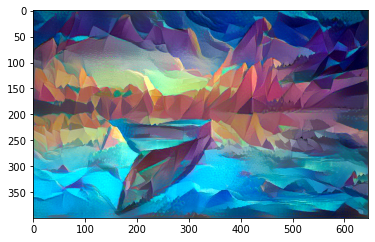

Image saved as:  my_result_at_iteration_920.png
Iteration 920 completed in 5s
Start of iteration:  921
Current loss:  99920380.0
Iteration 921 completed in 4s
Start of iteration:  922
Current loss:  99887220.0
Iteration 922 completed in 4s
Start of iteration:  923
Current loss:  99855830.0
Iteration 923 completed in 4s
Start of iteration:  924
Current loss:  99829310.0
Iteration 924 completed in 4s
Start of iteration:  925
Current loss:  99806424.0
Iteration 925 completed in 4s
Start of iteration:  926
Current loss:  99770376.0
Iteration 926 completed in 4s
Start of iteration:  927
Current loss:  99725270.0
Iteration 927 completed in 4s
Start of iteration:  928
Current loss:  99697040.0
Iteration 928 completed in 4s
Start of iteration:  929
Current loss:  99663440.0
Iteration 929 completed in 4s
Start of iteration:  930
Current loss:  99634980.0


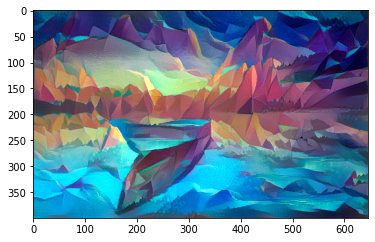

Image saved as:  my_result_at_iteration_930.png
Iteration 930 completed in 5s
Start of iteration:  931
Current loss:  99606580.0
Iteration 931 completed in 4s
Start of iteration:  932
Current loss:  99575416.0
Iteration 932 completed in 4s
Start of iteration:  933
Current loss:  99544520.0
Iteration 933 completed in 4s
Start of iteration:  934
Current loss:  99514150.0
Iteration 934 completed in 4s
Start of iteration:  935
Current loss:  99466300.0
Iteration 935 completed in 5s
Start of iteration:  936
Current loss:  99434180.0
Iteration 936 completed in 4s
Start of iteration:  937
Current loss:  99393260.0
Iteration 937 completed in 4s
Start of iteration:  938
Current loss:  99364860.0
Iteration 938 completed in 4s
Start of iteration:  939
Current loss:  99329016.0
Iteration 939 completed in 4s
Start of iteration:  940
Current loss:  99301816.0


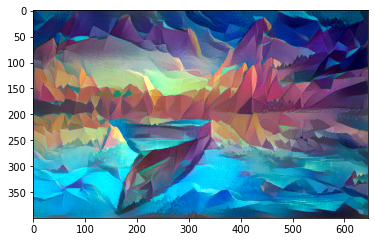

Image saved as:  my_result_at_iteration_940.png
Iteration 940 completed in 5s
Start of iteration:  941
Current loss:  99272584.0
Iteration 941 completed in 4s
Start of iteration:  942
Current loss:  99247464.0
Iteration 942 completed in 4s
Start of iteration:  943
Current loss:  99208210.0
Iteration 943 completed in 4s
Start of iteration:  944
Current loss:  99178650.0
Iteration 944 completed in 5s
Start of iteration:  945
Current loss:  99120030.0
Iteration 945 completed in 4s
Start of iteration:  946
Current loss:  99091480.0
Iteration 946 completed in 4s
Start of iteration:  947
Current loss:  99061784.0
Iteration 947 completed in 4s
Start of iteration:  948
Current loss:  99030590.0
Iteration 948 completed in 4s
Start of iteration:  949
Current loss:  98999090.0
Iteration 949 completed in 4s
Start of iteration:  950
Current loss:  98960040.0


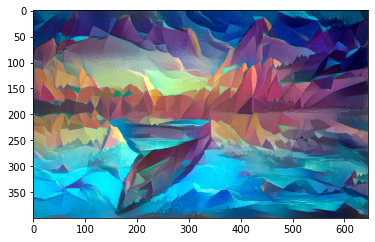

Image saved as:  my_result_at_iteration_950.png
Iteration 950 completed in 5s
Start of iteration:  951
Current loss:  98920184.0
Iteration 951 completed in 5s
Start of iteration:  952
Current loss:  98873220.0
Iteration 952 completed in 4s
Start of iteration:  953
Current loss:  98831920.0
Iteration 953 completed in 4s
Start of iteration:  954
Current loss:  98802040.0
Iteration 954 completed in 4s
Start of iteration:  955
Current loss:  98776984.0
Iteration 955 completed in 4s
Start of iteration:  956
Current loss:  98751020.0
Iteration 956 completed in 4s
Start of iteration:  957
Current loss:  98715470.0
Iteration 957 completed in 4s
Start of iteration:  958
Current loss:  98686260.0
Iteration 958 completed in 4s
Start of iteration:  959
Current loss:  98655340.0
Iteration 959 completed in 4s
Start of iteration:  960
Current loss:  98631750.0


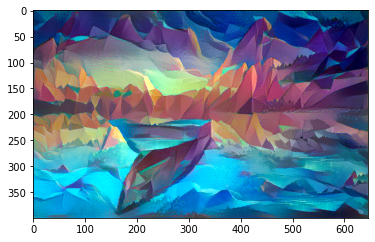

Image saved as:  my_result_at_iteration_960.png
Iteration 960 completed in 5s
Start of iteration:  961
Current loss:  98604520.0
Iteration 961 completed in 4s
Start of iteration:  962
Current loss:  98582136.0
Iteration 962 completed in 4s
Start of iteration:  963
Current loss:  98558280.0
Iteration 963 completed in 4s
Start of iteration:  964
Current loss:  98534904.0
Iteration 964 completed in 4s
Start of iteration:  965
Current loss:  98497120.0
Iteration 965 completed in 4s
Start of iteration:  966
Current loss:  98458480.0
Iteration 966 completed in 4s
Start of iteration:  967
Current loss:  98418270.0
Iteration 967 completed in 4s
Start of iteration:  968
Current loss:  98376890.0
Iteration 968 completed in 4s
Start of iteration:  969
Current loss:  98342540.0
Iteration 969 completed in 4s
Start of iteration:  970
Current loss:  98313590.0


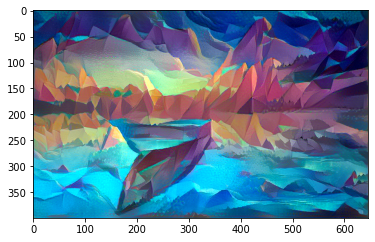

Image saved as:  my_result_at_iteration_970.png
Iteration 970 completed in 5s
Start of iteration:  971
Current loss:  98290540.0
Iteration 971 completed in 4s
Start of iteration:  972
Current loss:  98264970.0
Iteration 972 completed in 4s
Start of iteration:  973
Current loss:  98242440.0
Iteration 973 completed in 4s
Start of iteration:  974
Current loss:  98220050.0
Iteration 974 completed in 4s
Start of iteration:  975
Current loss:  98197830.0
Iteration 975 completed in 4s
Start of iteration:  976
Current loss:  98177576.0
Iteration 976 completed in 4s
Start of iteration:  977
Current loss:  98140030.0
Iteration 977 completed in 4s
Start of iteration:  978
Current loss:  98112560.0
Iteration 978 completed in 4s
Start of iteration:  979
Current loss:  98083840.0
Iteration 979 completed in 4s
Start of iteration:  980
Current loss:  98047740.0


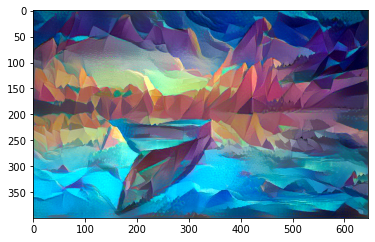

Image saved as:  my_result_at_iteration_980.png
Iteration 980 completed in 5s
Start of iteration:  981
Current loss:  98024690.0
Iteration 981 completed in 4s
Start of iteration:  982
Current loss:  97999410.0
Iteration 982 completed in 4s
Start of iteration:  983
Current loss:  97974620.0
Iteration 983 completed in 5s
Start of iteration:  984
Current loss:  97950460.0
Iteration 984 completed in 4s
Start of iteration:  985
Current loss:  97920060.0
Iteration 985 completed in 4s
Start of iteration:  986
Current loss:  97891816.0
Iteration 986 completed in 4s
Start of iteration:  987
Current loss:  97857740.0
Iteration 987 completed in 4s
Start of iteration:  988
Current loss:  97831260.0
Iteration 988 completed in 4s
Start of iteration:  989
Current loss:  97799930.0
Iteration 989 completed in 4s
Start of iteration:  990
Current loss:  97768060.0


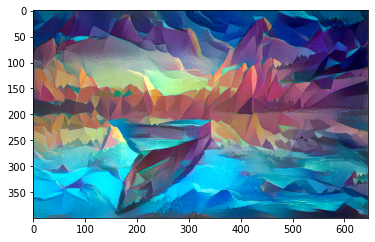

Image saved as:  my_result_at_iteration_990.png
Iteration 990 completed in 5s
Start of iteration:  991
Current loss:  97731300.0
Iteration 991 completed in 4s
Start of iteration:  992
Current loss:  97705300.0
Iteration 992 completed in 4s
Start of iteration:  993
Current loss:  97679620.0
Iteration 993 completed in 4s
Start of iteration:  994
Current loss:  97653380.0
Iteration 994 completed in 4s
Start of iteration:  995
Current loss:  97616450.0
Iteration 995 completed in 4s
Start of iteration:  996
Current loss:  97573980.0
Iteration 996 completed in 4s
Start of iteration:  997
Current loss:  97535430.0
Iteration 997 completed in 4s
Start of iteration:  998
Current loss:  97506110.0
Iteration 998 completed in 4s
Start of iteration:  999
Current loss:  97476584.0


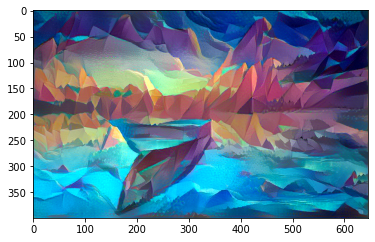

Image saved as:  my_result_at_iteration_999.png
Iteration 999 completed in 5s


In [0]:
from scipy.optimize import fmin_l_bfgs_b
from tensorflow.keras.preprocessing.image import save_img
import time
result_prefix = 'my_result'
evaluator = Evaluator()

iterations = 1000
save_on_iteration = 10
x = preprocess_image(target_image_path)
for i in range(iterations):
  print('Start of iteration: ', i)
  start_time = time.time()
  x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                   fprime=evaluator.grads, maxfun=20)
  print('Current loss: ', min_val)                                  

  # Save every x iteration

  if i % save_on_iteration == 0 or i == iterations - 1:
    img = deprocess_image(x.copy())
    fname = result_prefix + '_at_iteration_%d.png' % i
    save_img(fname, img)
    show_image(fname)
    print('Image saved as: ', fname)
  end_time = time.time()
  print('Iteration %d completed in %ds' % (i, end_time - start_time))


Base Image


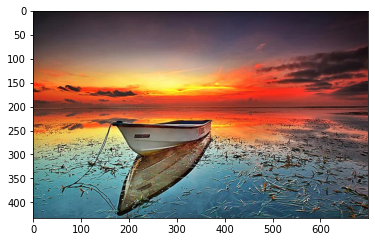

Style reference


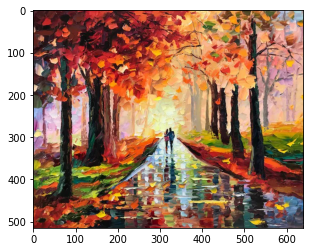

Combine Image


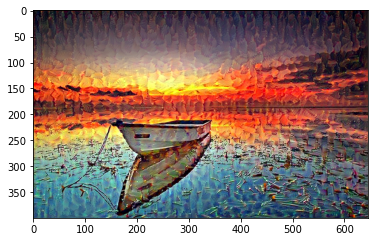

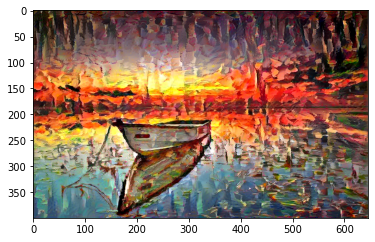

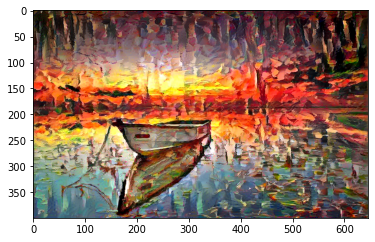

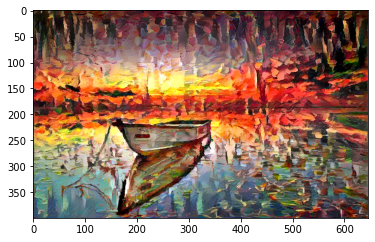

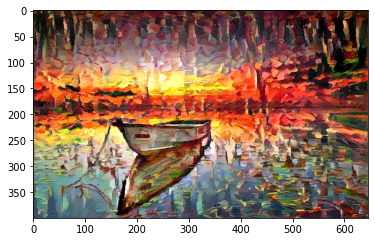

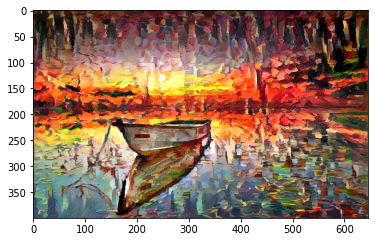

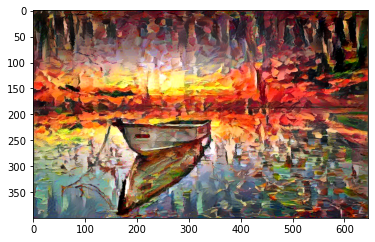

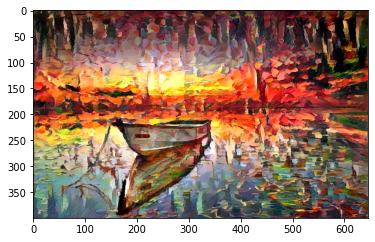

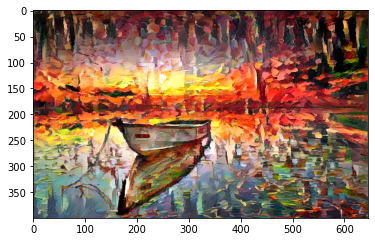

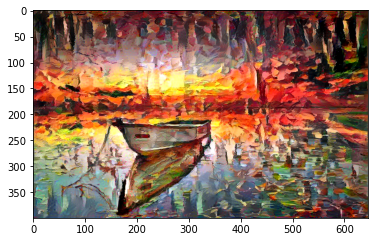

In [0]:
print('Base Image')
show_image('boat.jpg')
print('Style reference')
show_image('beautifulnight.jpg')
print('Combine Image')
for i in range(10):
  show_image('my_result_at_iteration_%d.png' % (100 * i))

## Images Without Total Variation Loss

Base Image


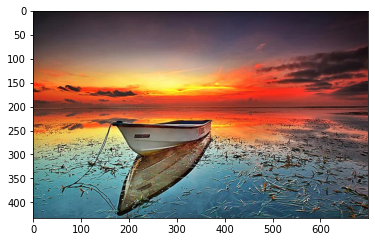

Style reference


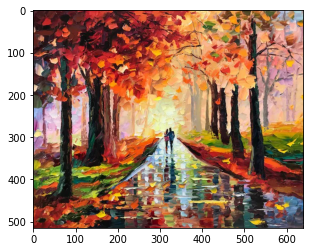

Combine Image


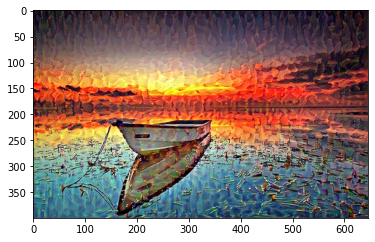

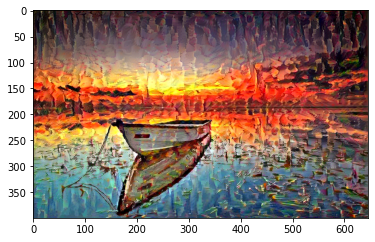

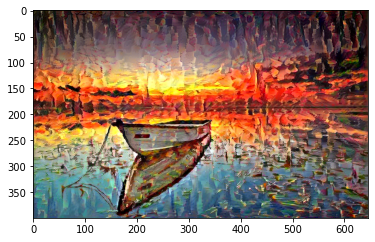

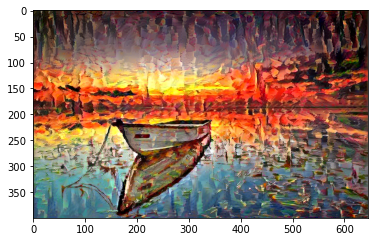

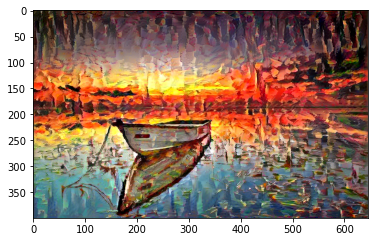

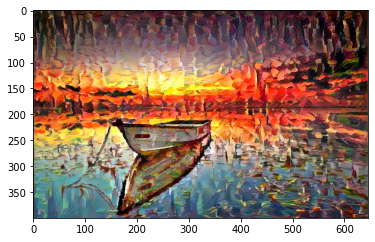

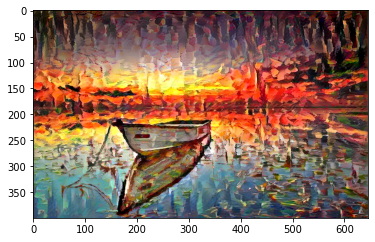

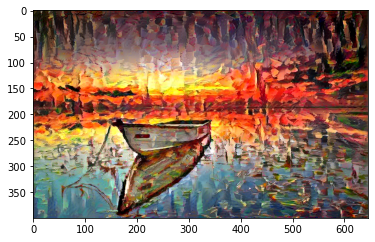

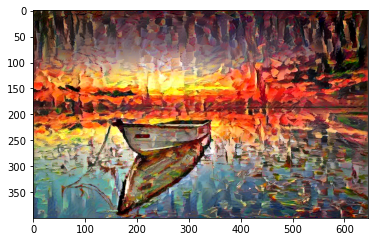

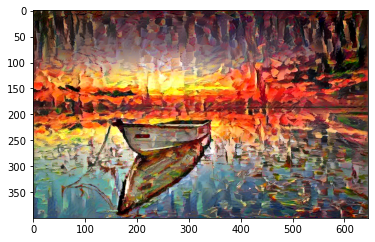

In [0]:
print('Base Image')
show_image('boat.jpg')
print('Style reference')
show_image('beautifulnight.jpg')
print('Combine Image')
for i in range(10):
  show_image('my_result_at_iteration_%d.png' % (10 * i))